In [9]:
from time import time
import torchreid
import torch
import os.path as osp
from glob import glob
import numpy as np
import numpy.ma as ma
import cv2
import os
import matplotlib.pyplot as plt
%matplotlib inline

from torchreid.utils import FeatureExtractor
from automatic_threshold_finder import ThresholdFinder
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


## Init ReID and YOLO models

In [2]:
model_name = 'osnet_x1_0'  # osnet_x1_0, shufflenet_v2_x1_0
model_path = f"log/17_10_2022/model/model.pth.tar-20"

reid_model = FeatureExtractor(
    model_name=model_name,
    model_path=model_path,
    device=device,
    image_size=(256, 128),
    verbose=False
)

yolo_model_name = 'yolov5s'
yolo_model = torch.hub.load('ultralytics/yolov5', yolo_model_name)

Successfully loaded imagenet pretrained weights from "/home/server/.cache/torch/checkpoints/osnet_x1_0_imagenet.pth"
** The following layers are discarded due to unmatched keys or layer size: ['classifier.weight', 'classifier.bias']
Successfully loaded pretrained weights from "log/17_10_2022_blink/model/model.pth.tar-20"
** The following layers are discarded due to unmatched keys or layer size: ['classifier.weight', 'classifier.bias']


Using cache found in /home/server/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-10-17 Python-3.6.9 torch-1.8.0 CUDA:0 (NVIDIA GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 


WARNING ⚠️ Python 3.7.0 is required by YOLOv5, but Python 3.6.9 is currently installed


YOLOv5s_v6 summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


# Utils

In [3]:
def plot_img(img):
    """
    Plot image in RGB 
    """
    assert img.shape[-1] == 3 and len(img.shape) == 3, 'Not an image.'
    plt.imshow(img[..., ::-1])
    plt.show()


def create_customer_encs(path, reid_model, plot=True):
    '''
    Giving a path for customer's pictures and ReID model, calculating encodings.
    Set plot=True if you want to see pictures that will be used to calculate encodings
    '''
    names, cust_encs = [], []
    
    for folder in glob(path + '/*'):
        name = folder.split('/')[-1]
        print(f'Customer {name}')
        names.append(name)

        imgs = []
        for image_path in glob(folder + '/*'):
            face = cv2.imread(image_path)
            imgs.append(face)
            
            if plot:
                plot_img(face)
            
        encs = reid_model(imgs)  
        cust_encs.append(encs.cpu().detach().numpy())
    
    return np.array(cust_encs), names


def compute_conf_matr(customer_encodings, frame_current_encodings, thresholds):
    """
    Calculating confusion matrix which reperesents the matchings 
    between frame's people with customers using their encodings 
    """
    # broadcasting all customer encodings tensor with current frame's people encodings
    diff = customer_encodings[:, None, ...] - frame_current_encodings[None, :, None, ...]
    # using l2-norm for calculating distance between encodings
    conf_matr = (diff ** 2).mean(axis=-1) ** 0.5  
    # comparing results with thresholds and getting scores of matchings
    conf_matr = (conf_matr < thresholds[0]).mean(axis=-1)  
    print('after first threshold\n', conf_matr)
    # taking the highest probable matches from rows
    max_values_indexes = np.argmax(conf_matr, axis=-1)  
    rows = np.arange(0, conf_matr.shape[0])
    # taking high matching scores
    max_values = conf_matr[rows, max_values_indexes]
    # cleaning the matrix by inserting zeros
    conf_matr *= 0
    # inserting back the high scores
    conf_matr[rows, max_values_indexes] = max_values
    # taking the highest probable matches from columns to be sure that 
    # there are no more than one high score for a single person 
    max_values_indexes = np.argmax(conf_matr, axis=0)
    columns = np.arange(0, conf_matr.shape[1])
    max_values = conf_matr[max_values_indexes, columns]
    # cleaning the matrix by inserting zeros
    conf_matr *= 0
    # inserting back the high scores
    conf_matr[max_values_indexes, columns] = max_values
    # comparing the results with the last threshold
    conf_matr = conf_matr >= thresholds[1] 
    
    return conf_matr * 1


def plot_customer_names(frame, conf_matr, coords, customer_names):
    """
    Applying names of the customers on the image, by taking 
    the indices of names from confusion matrix
    """
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontScale = 1.5
    color = (0, 0, 255)
    thickness = 3

    img = np.copy(frame)
    for i in range(conf_matr.shape[1]):
        frame_people = np.where(conf_matr[:, i])[0]
        
        if len(frame_people) == 0:
            name = '###'  # for not customer person 
        else:
            name = customer_names[frame_people[0]]
            
        text_coords = int(coords[i][0]), int(coords[i][1])
        
        video_frame = cv2.putText(img, name, text_coords, font, fontScale, color, thickness, cv2.LINE_AA)

    plot_img(video_frame)
    plt.show()
    print('-' * 80)
    
    return video_frame

## Calculate customer encodings

In [5]:
# here place your path for customer encodings
# Note: your folder must contain images in this order
# ./path/to/customer/data
# ├── person_1_name
# |  ├── image_1
# |  ├── image_2                    
# |  ├── ...                     
# |  ├── ...                    
# |  └── image_m
# |
# ├── person_2_name
# |  ├── image_1
# |  ├── image_2                    
# |  ├── ...                     
# |  ├── ...                    
# |  └── image_m                    
# |
# ├── ...                     
# ├── ...                    
# └── person_n_name
#    ├── image_1
#    ├── image_2                    
#    ├── ...                     
#    ├── ...                    
#    └── image_m

customer_encs_path = 'Encodings/07_04_22_encs'
customer_encs, customer_names = create_customer_encs(customer_encs_path, reid_model, plot=False)
print(customer_encs.shape, customer_names)

Customer Adam
Customer Rob
Customer Lida
(3, 23, 512) ['Adam', 'Rob', 'Lida']


## Inference 

after first threshold
 [[    0.86957           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


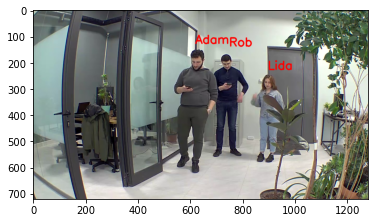

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


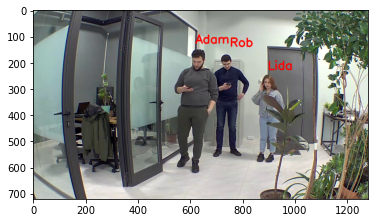

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.95652           0]
 [          0           0     0.91304]]


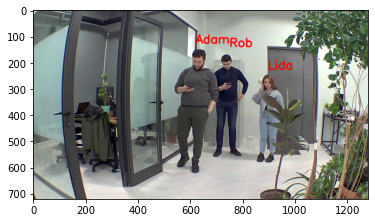

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


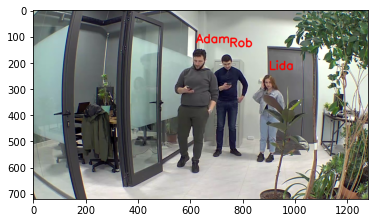

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


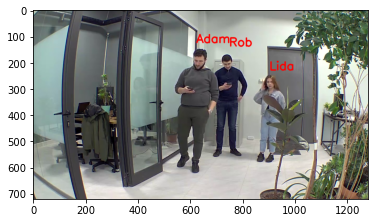

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.91304           0]
 [          0           0     0.95652]]


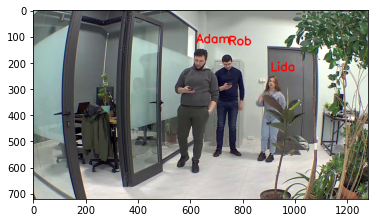

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


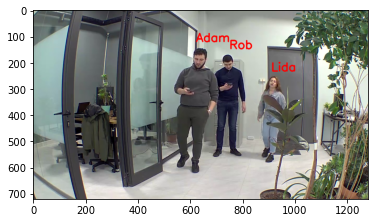

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


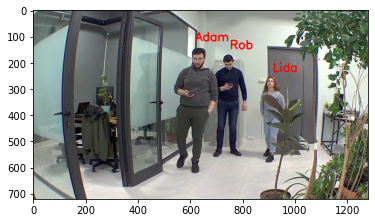

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


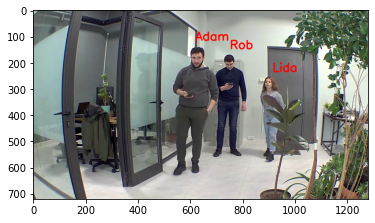

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [   0.043478     0.78261           0]
 [          0           0     0.95652]]


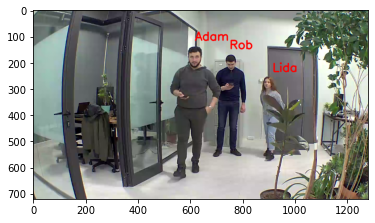

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.73913           0]
 [          0           0     0.95652]]


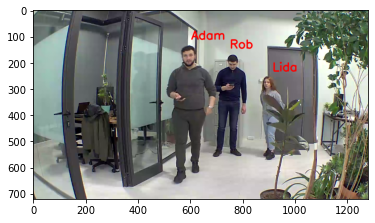

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.91304           0]
 [          0    0.043478     0.95652]]


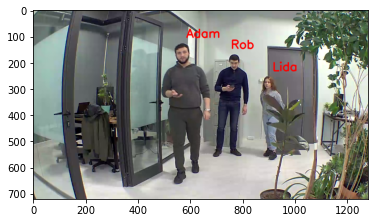

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.95652           0]
 [          0    0.043478     0.95652]]


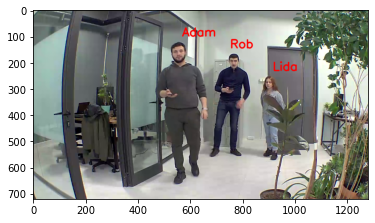

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [          0     0.95652           0]
 [          0           0     0.95652]]


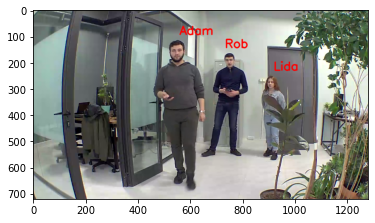

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [          0     0.86957           0]
 [          0           0     0.95652]]


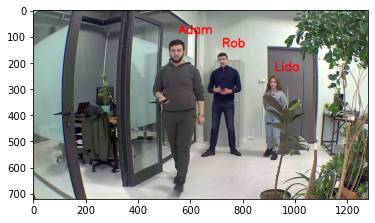

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0           0]
 [          0     0.86957           0    0.043478]
 [          0           0     0.82609     0.56522]]


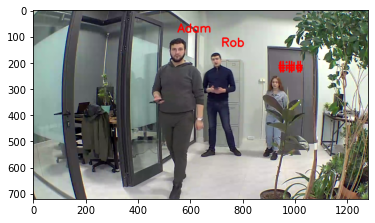

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [          0     0.91304           0]
 [          0    0.043478     0.95652]]


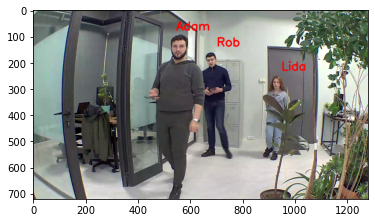

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0           0]
 [          0     0.69565     0.17391    0.043478]
 [          0           0     0.69565     0.13043]]


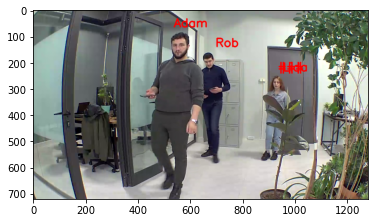

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.82609     0.26087]
 [          0    0.043478     0.78261]]


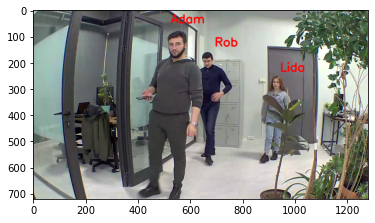

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [   0.043478     0.78261           0]
 [          0     0.13043     0.95652]]


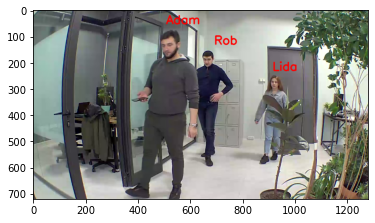

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.82609           0]
 [          0     0.17391     0.95652]]


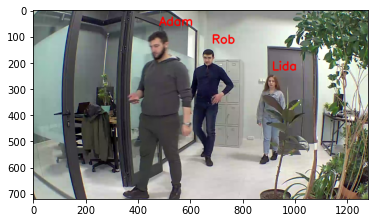

--------------------------------------------------------------------------------
after first threshold
 [[     0.6087           0           0]
 [    0.13043     0.95652           0]
 [          0    0.043478     0.95652]]


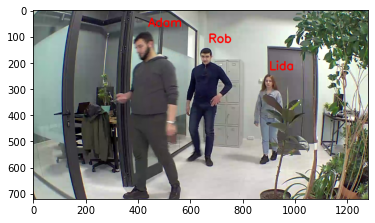

--------------------------------------------------------------------------------
after first threshold
 [[    0.30435           0           0]
 [    0.43478           1           0]
 [          0           0     0.95652]]


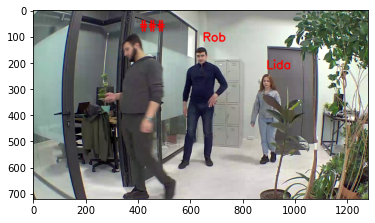

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0]
 [    0.43478     0.95652           0]
 [   0.043478           0     0.95652]]


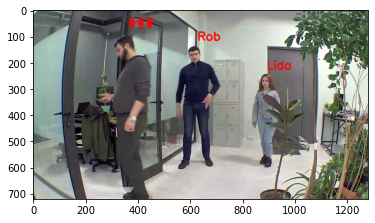

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [    0.26087     0.95652    0.043478]
 [          0    0.043478     0.95652]]


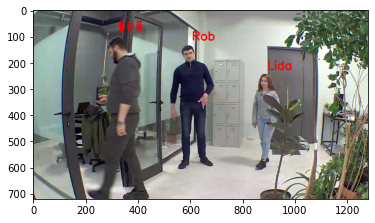

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [    0.13043     0.95652           0]
 [          0    0.043478     0.95652]]


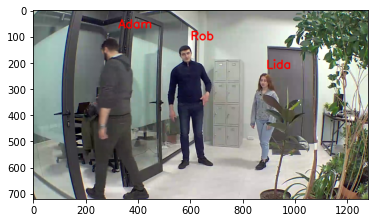

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [          0     0.95652           0]
 [          0    0.043478     0.95652]]


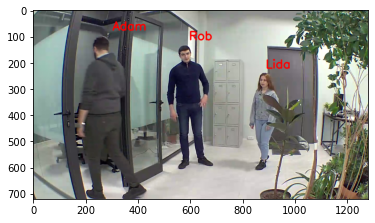

--------------------------------------------------------------------------------
after first threshold
 [[    0.34783           0           0]
 [    0.13043     0.95652    0.043478]
 [          0    0.043478     0.95652]]


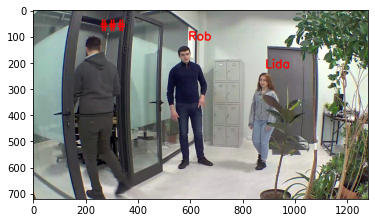

--------------------------------------------------------------------------------
after first threshold
 [[    0.82609           0           0]
 [   0.086957     0.95652           0]
 [          0    0.043478     0.95652]]


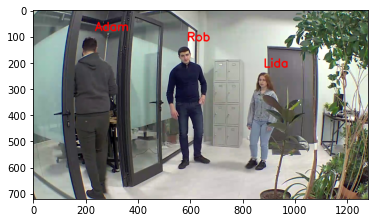

--------------------------------------------------------------------------------
after first threshold
 [[    0.82609           0           0]
 [   0.086957     0.95652           0]
 [          0           0     0.95652]]


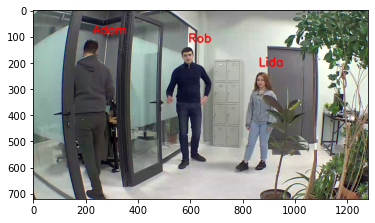

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [   0.043478     0.95652           0]
 [          0           0     0.95652]]


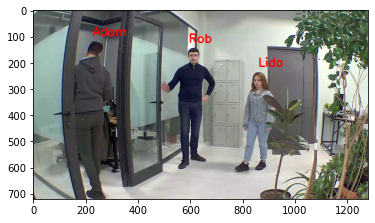

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [   0.043478           1           0]
 [          0    0.043478     0.95652]]


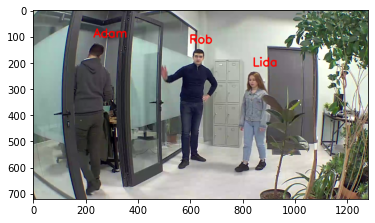

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [   0.086957     0.95652           0]
 [          0    0.043478     0.95652]]


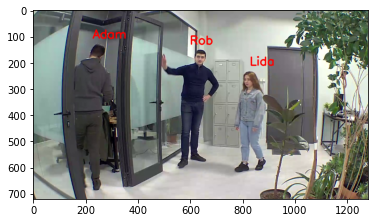

--------------------------------------------------------------------------------
after first threshold
 [[    0.82609           0           0]
 [   0.086957     0.95652    0.043478]
 [          0    0.043478     0.95652]]


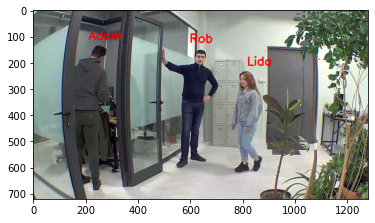

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [    0.13043     0.95652    0.086957]
 [          0    0.043478     0.91304]]


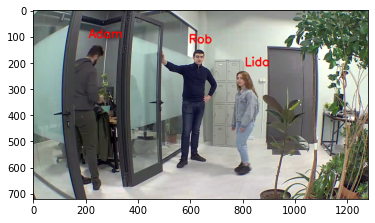

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0           0]
 [    0.78261     0.95652           0]
 [          0    0.043478     0.95652]]


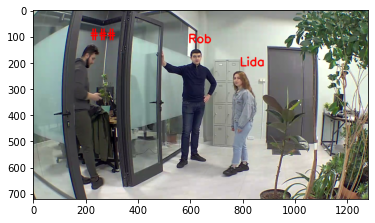

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0           0]
 [    0.47826     0.95652    0.043478]
 [          0    0.043478     0.95652]]


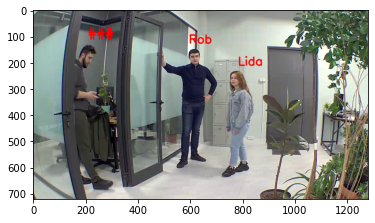

--------------------------------------------------------------------------------
after first threshold
 [[   0.086957           0           0           0]
 [    0.52174     0.13043     0.95652           0]
 [          0     0.78261    0.043478     0.95652]]


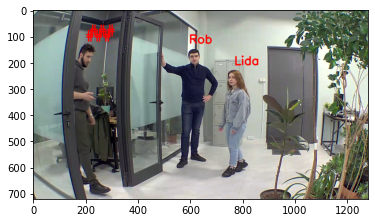

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0           0]
 [    0.26087     0.95652    0.043478]
 [          0    0.043478     0.86957]]


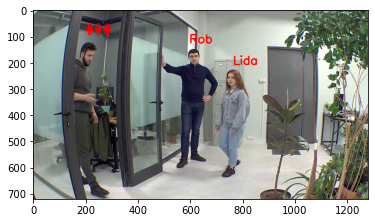

--------------------------------------------------------------------------------
after first threshold
 [[    0.69565           0           0]
 [    0.13043     0.95652           0]
 [          0    0.043478     0.86957]]


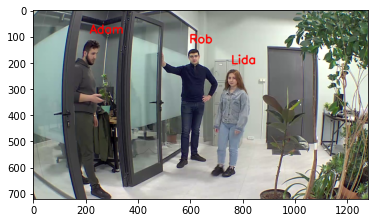

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0           0]
 [    0.13043           1           0]
 [          0    0.043478     0.86957]]


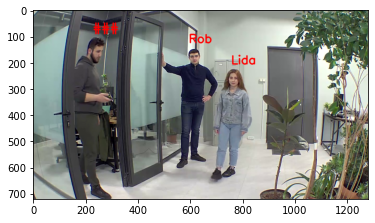

--------------------------------------------------------------------------------
after first threshold
 [[    0.30435           0           0]
 [    0.13043     0.95652           0]
 [          0    0.043478     0.73913]]


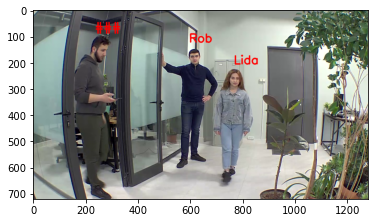

--------------------------------------------------------------------------------
after first threshold
 [[    0.47826           0           0]
 [    0.13043     0.95652    0.043478]
 [          0           0     0.73913]]


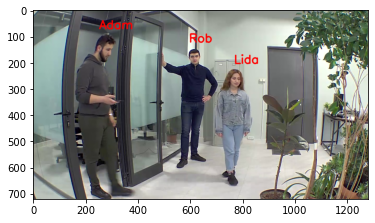

--------------------------------------------------------------------------------
after first threshold
 [[     0.6087           0           0]
 [   0.043478     0.95652           0]
 [          0           0     0.73913]]


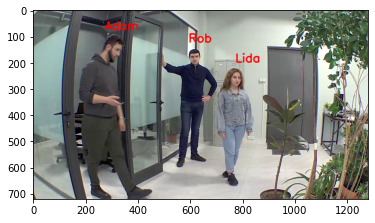

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [          0     0.95652    0.043478]
 [          0           0     0.82609]]


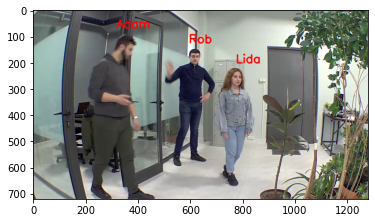

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [          0           1    0.043478]
 [          0    0.043478     0.73913]]


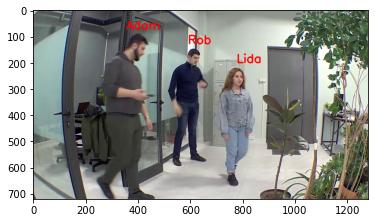

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [   0.043478     0.95652    0.086957]
 [          0           0     0.82609]]


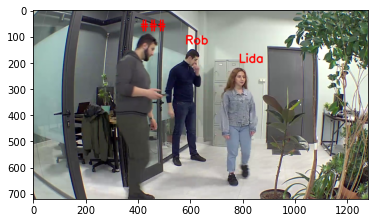

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [    0.13043     0.95652    0.043478]
 [          0           0     0.86957]]


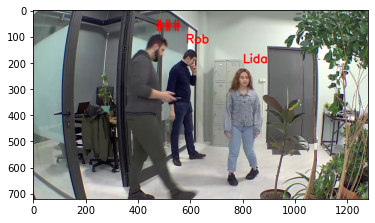

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [    0.13043      0.3913    0.043478]
 [          0     0.78261     0.91304]]


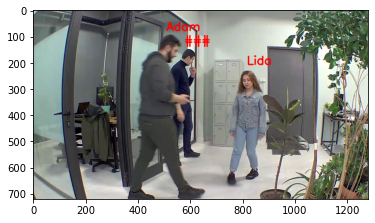

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0]
 [          0     0.13043]
 [          0     0.95652]]


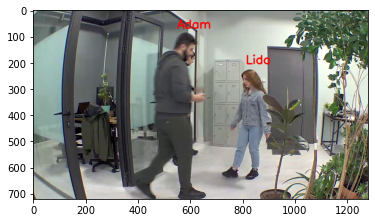

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0]
 [          0    0.086957]
 [          0     0.91304]]


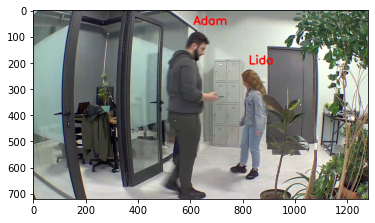

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0]
 [          0    0.086957]
 [          0     0.73913]]


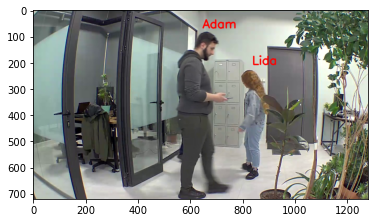

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478     0.82609           0]
 [    0.95652    0.043478           0]
 [          0           0     0.95652]]


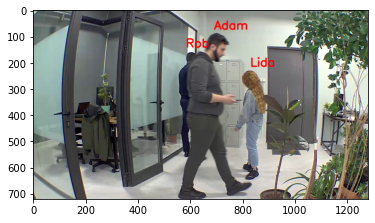

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174     0.82609           0]
 [    0.56522     0.17391           0]
 [          0           0     0.95652]]


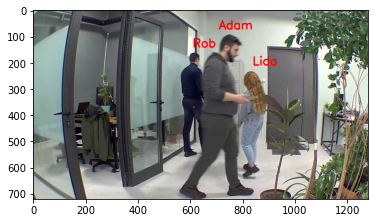

--------------------------------------------------------------------------------
after first threshold
 [[    0.30435     0.78261]
 [     0.6087     0.13043]
 [          0           0]]


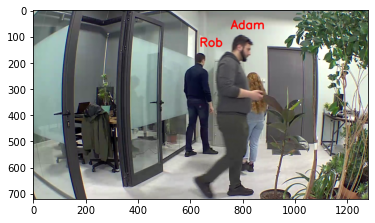

--------------------------------------------------------------------------------
after first threshold
 [[    0.21739     0.91304]
 [    0.86957           0]
 [          0           0]]


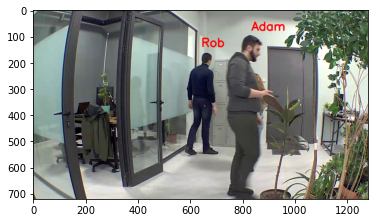

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478     0.95652]
 [    0.86957           0]
 [          0           0]]


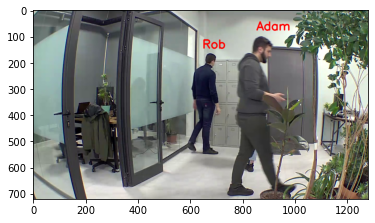

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [    0.95652    0.043478]
 [          0           0]]


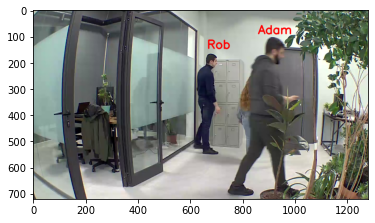

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.86957           0]
 [   0.043478     0.95652]]


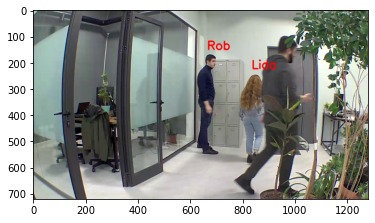

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.82609     0.17391]
 [   0.043478     0.47826]]


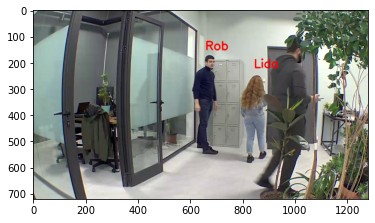

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652     0.30435]
 [   0.043478     0.86957]]


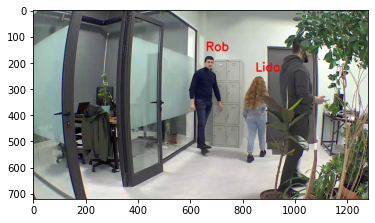

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652     0.34783]
 [   0.043478     0.86957]]


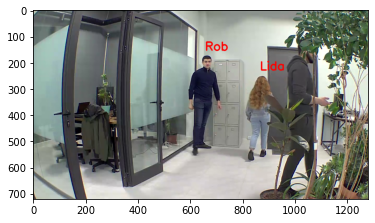

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.17391]
 [    0.95652     0.43478     0.52174]
 [   0.043478     0.86957           0]]


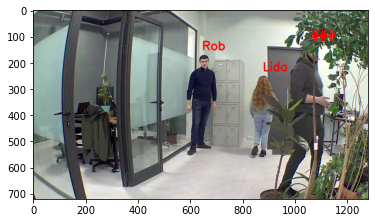

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.26087]
 [          1     0.30435     0.43478]
 [          0     0.91304           0]]


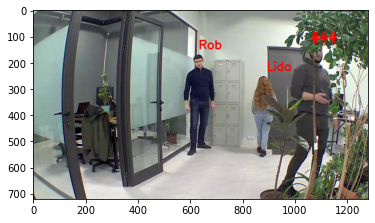

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.26087]
 [    0.95652     0.47826     0.26087]
 [          0      0.6087           0]]


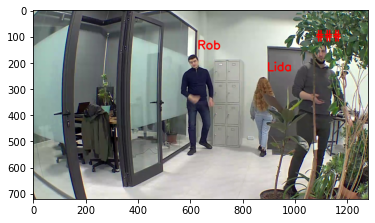

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.13043]
 [    0.91304      0.3913     0.73913]
 [   0.043478     0.82609           0]]


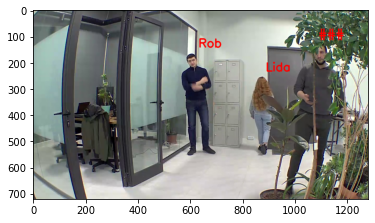

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.13043]
 [    0.86957     0.34783     0.21739]
 [   0.043478     0.95652           0]]


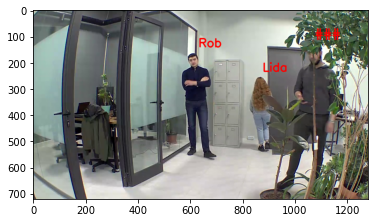

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.34783]
 [    0.91304     0.52174    0.043478]
 [          0     0.26087           0]]


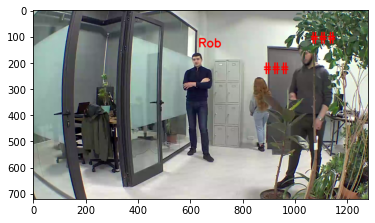

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.26087]
 [    0.95652      0.3913     0.13043]
 [          0     0.21739           0]]


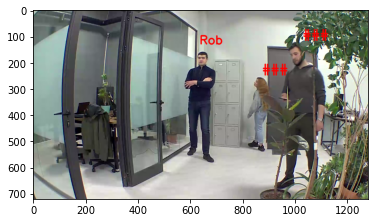

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.56522]
 [    0.91304     0.34783    0.043478]
 [          0     0.91304           0]]


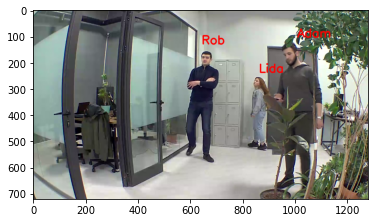

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.82609]
 [    0.86957     0.13043     0.26087]
 [   0.043478     0.95652           0]]


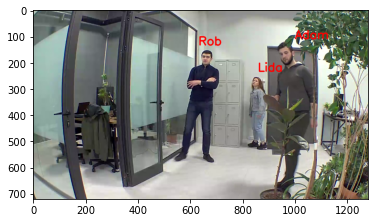

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.52174]
 [    0.95652    0.043478     0.17391]
 [   0.043478     0.95652           0]]


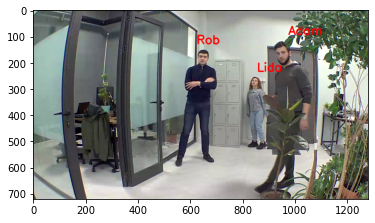

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.47826]
 [    0.95652           0    0.043478]
 [   0.043478     0.95652           0]]


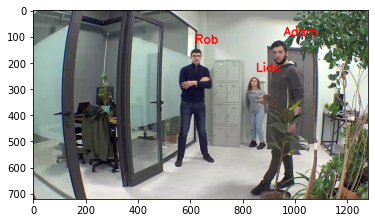

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.56522]
 [    0.91304           0    0.086957]
 [          0     0.95652           0]]


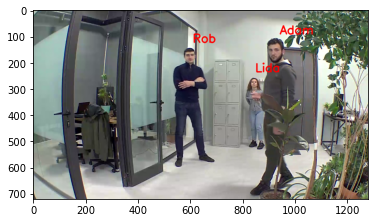

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.78261]
 [    0.95652    0.043478]
 [   0.043478           0]]


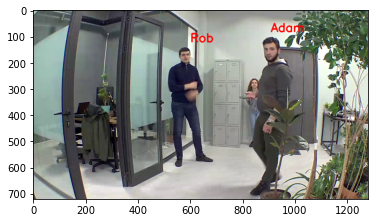

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043     0.82609]
 [    0.95652    0.043478]
 [          0           0]]


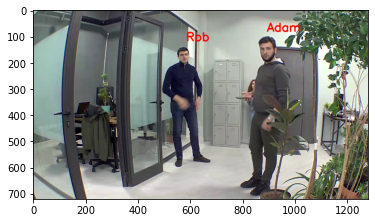

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.82609]
 [    0.95652           0]
 [   0.043478           0]]


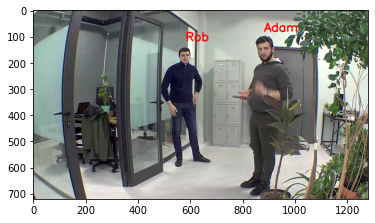

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304]
 [    0.95652           0]
 [   0.043478           0]]


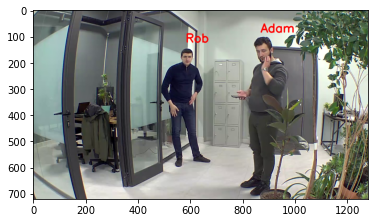

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304]
 [    0.95652           0]
 [   0.043478           0]]


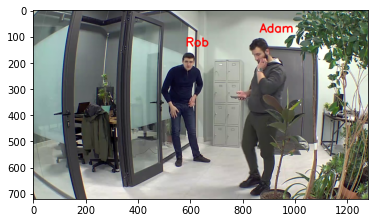

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652]
 [    0.69565           0]
 [    0.21739           0]]


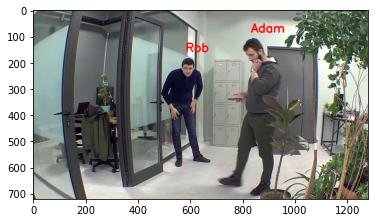

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304]
 [    0.56522           0]
 [    0.65217           0]]


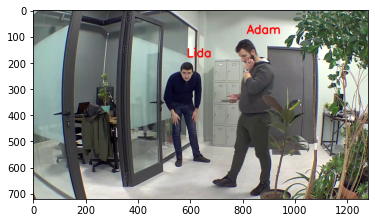

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [    0.56522           0]
 [    0.82609           0]]


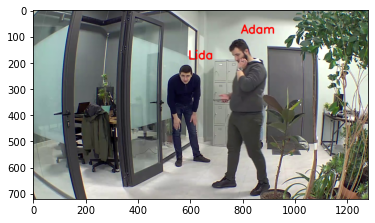

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [    0.69565           0]
 [    0.26087           0]]


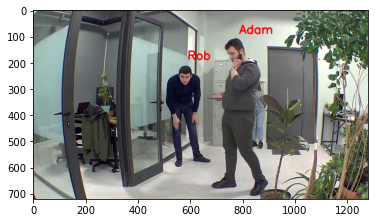

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652           0]
 [    0.69565           0           0]
 [     0.3913           0     0.95652]]


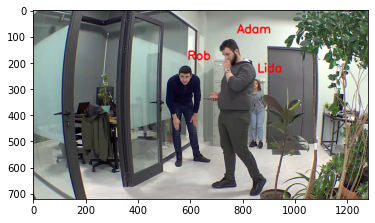

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652           0]
 [    0.73913           0           0]
 [    0.26087           0     0.95652]]


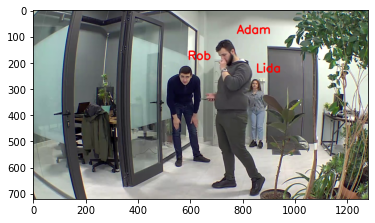

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957           0]
 [    0.73913           0    0.043478]
 [    0.21739           0     0.82609]]


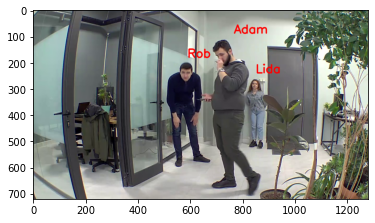

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304           0           0]
 [    0.69565    0.043478           0    0.043478]
 [    0.17391           0     0.78261     0.73913]]


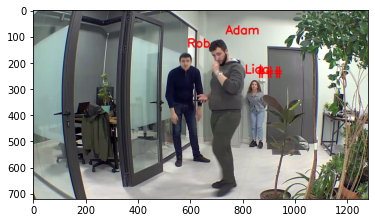

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.47826           0]
 [    0.78261      0.3913    0.043478]
 [   0.086957           0     0.73913]]


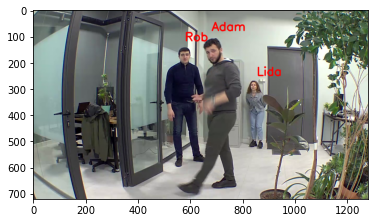

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.56522           0]
 [     0.6087     0.34783    0.043478]
 [    0.56522           0     0.73913]]


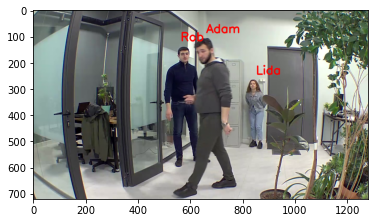

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.82609           0]
 [    0.78261     0.13043    0.043478]
 [    0.17391           0     0.73913]]


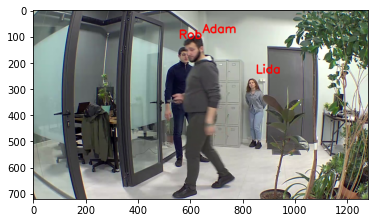

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0]
 [   0.043478    0.043478]
 [          0     0.56522]]


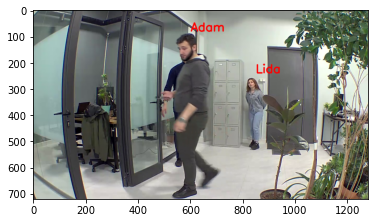

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0]
 [   0.043478    0.043478]
 [          0     0.65217]]


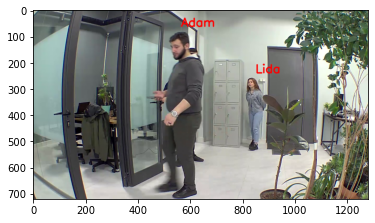

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652     0.34783           0]
 [          0      0.3913    0.043478]
 [          0           0     0.52174]]


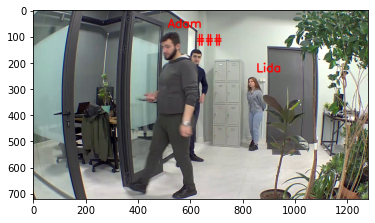

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0    0.043478    0.043478]
 [          0     0.69565     0.52174]]


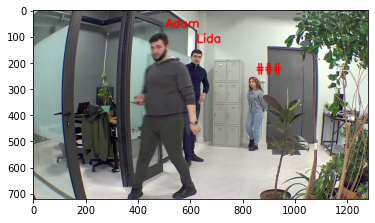

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [          0     0.56522    0.043478]
 [          0     0.69565     0.82609]]


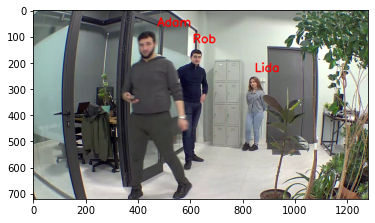

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [   0.086957     0.95652    0.043478]
 [          0    0.043478     0.73913]]


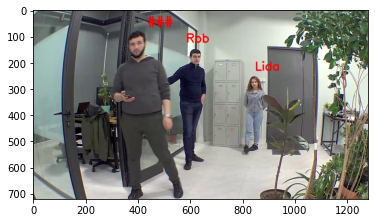

--------------------------------------------------------------------------------
after first threshold
 [[    0.82609           0           0]
 [   0.043478     0.95652    0.043478]
 [          0    0.043478     0.52174]]


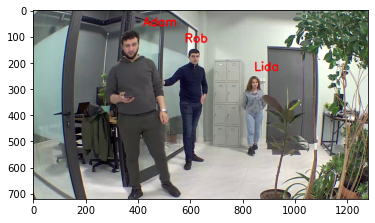

--------------------------------------------------------------------------------
after first threshold
 [[    0.73913           0           0]
 [   0.086957     0.95652           0]
 [          0    0.043478     0.26087]]


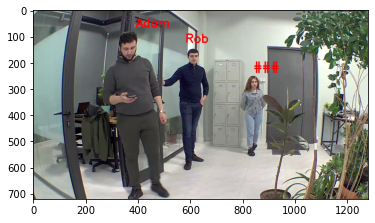

--------------------------------------------------------------------------------
after first threshold
 [[    0.69565           0           0]
 [   0.086957     0.95652    0.043478]
 [          0    0.043478     0.52174]]


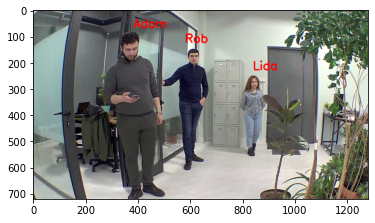

--------------------------------------------------------------------------------
after first threshold
 [[    0.56522           0           0]
 [    0.13043     0.95652           0]
 [          0    0.043478     0.82609]]


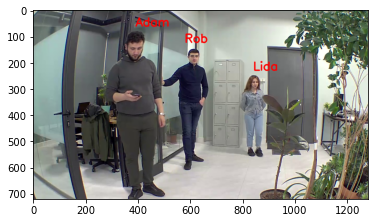

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0           0]
 [    0.13043     0.95652    0.043478]
 [          0    0.043478     0.82609]]


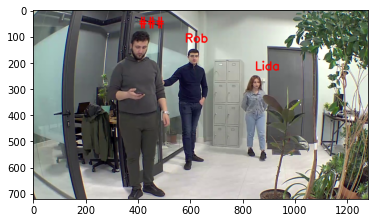

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [    0.17391     0.95652           0]
 [          0    0.043478     0.86957]]


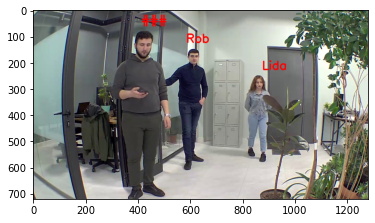

--------------------------------------------------------------------------------
after first threshold
 [[    0.47826           0           0]
 [   0.086957     0.95652           0]
 [          0    0.043478     0.95652]]


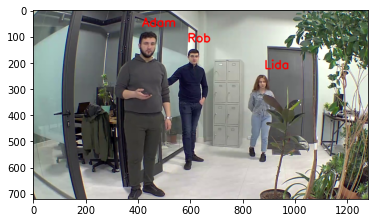

--------------------------------------------------------------------------------
after first threshold
 [[    0.47826           0           0]
 [   0.043478           1           0]
 [          0    0.043478     0.95652]]


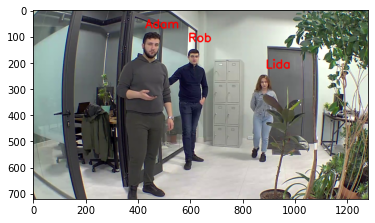

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0           0]
 [   0.043478           1           0]
 [          0    0.043478     0.95652]]


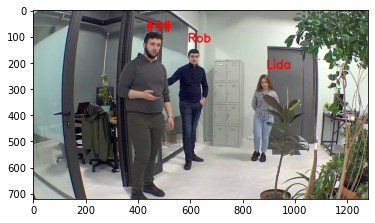

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [          0     0.95652           0]
 [          0    0.043478     0.91304]]


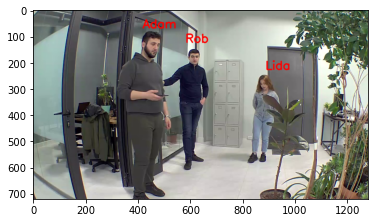

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [          0     0.95652           0]
 [          0    0.043478     0.86957]]


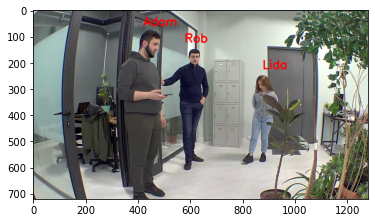

--------------------------------------------------------------------------------
after first threshold
 [[    0.69565           0           0]
 [   0.043478     0.95652    0.043478]
 [          0    0.043478     0.91304]]


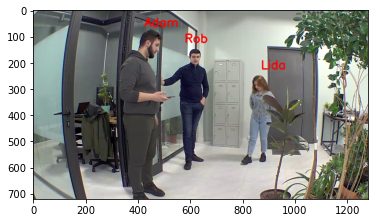

--------------------------------------------------------------------------------
after first threshold
 [[    0.52174           0           0]
 [   0.043478     0.95652    0.043478]
 [          0    0.043478     0.82609]]


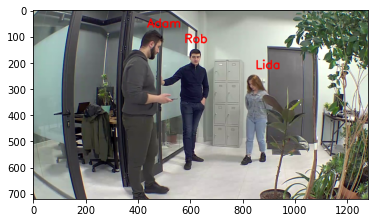

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0]
 [          0     0.95652    0.043478]
 [          0    0.043478     0.69565]]


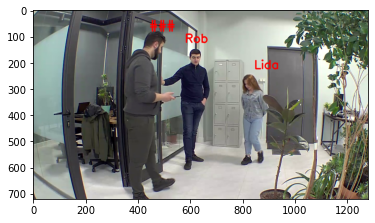

--------------------------------------------------------------------------------
after first threshold
 [[    0.65217           0           0]
 [   0.043478     0.95652           0]
 [          0    0.043478     0.17391]]


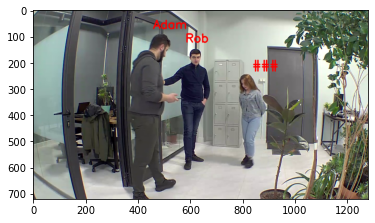

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.95652           0]
 [          0    0.043478     0.17391]]


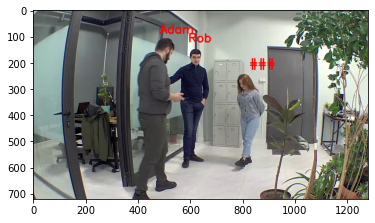

--------------------------------------------------------------------------------
after first threshold
 [[    0.78261           0           0]
 [    0.13043     0.95652           0]
 [          0           0    0.086957]]


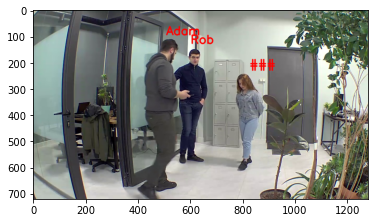

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304    0.043478           0]
 [   0.086957     0.95652           0]
 [          0           0     0.17391]]


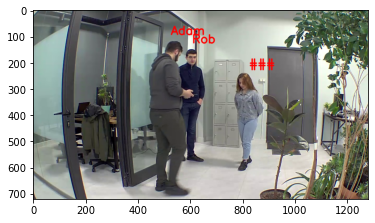

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.65217           0]
 [          0    0.086957    0.086957]]


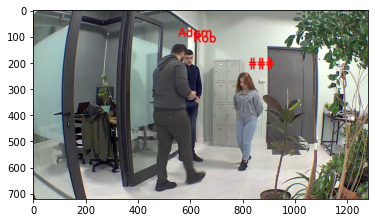

--------------------------------------------------------------------------------
after first threshold
 [[    0.78261           0]
 [          0           0]
 [          0     0.21739]]


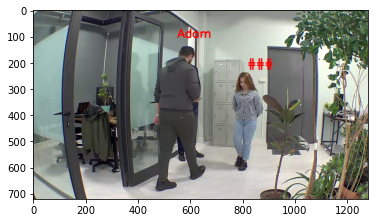

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0]
 [          0           0]
 [          0     0.26087]]


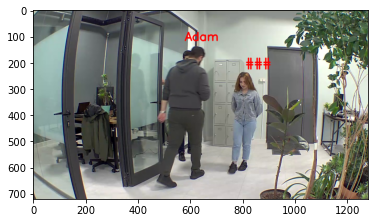

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.82609           0]
 [    0.26087           0           0]
 [          0           0     0.13043]]


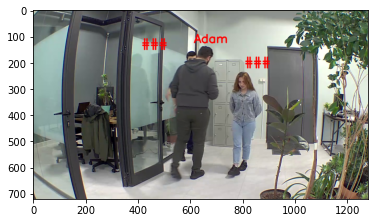

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0]
 [          0           0]
 [          0     0.17391]]


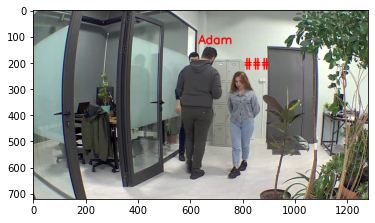

--------------------------------------------------------------------------------
after first threshold
 [[          1           0]
 [          0           0]
 [          0    0.043478]]


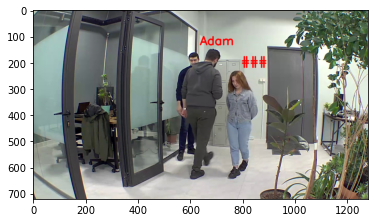

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957           0]
 [    0.82609     0.13043    0.043478]
 [   0.043478           0     0.65217]]


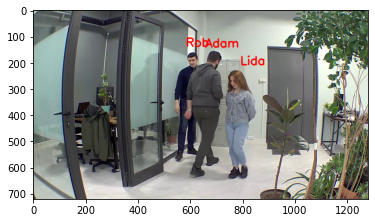

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304           0]
 [    0.95652           0           0]
 [   0.043478           0     0.47826]]


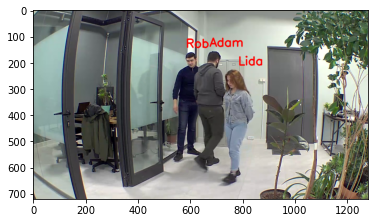

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304           0]
 [    0.95652           0    0.086957]
 [   0.043478           0      0.3913]]


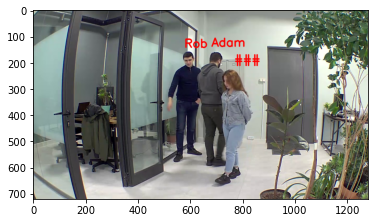

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957           0]
 [    0.95652           0           0]
 [   0.043478           0     0.95652]]


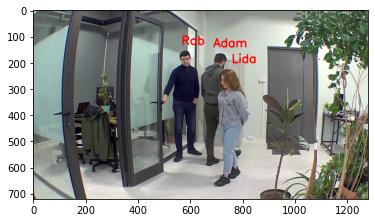

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.52174           0]
 [    0.82609           0     0.52174]
 [   0.043478           0     0.17391]]


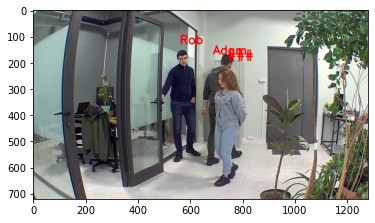

--------------------------------------------------------------------------------
after first threshold
 [[          0           0    0.086957           0]
 [    0.82609     0.34783     0.21739           0]
 [   0.043478     0.86957           0     0.56522]]


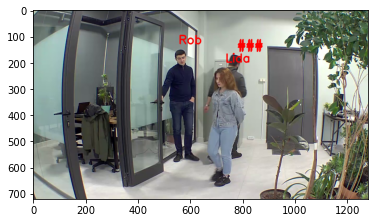

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.52174]
 [    0.78261           0    0.043478]
 [   0.043478     0.86957           0]]


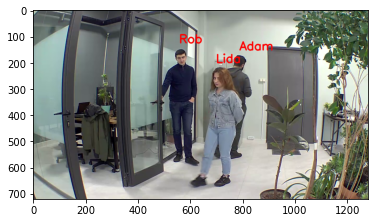

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.91304           0           0]
 [   0.043478     0.82609           0]]


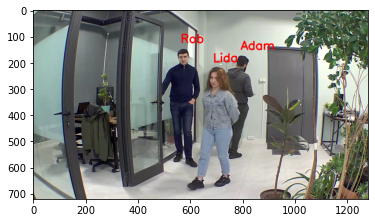

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.82609           0           0]
 [   0.043478     0.82609           0]]


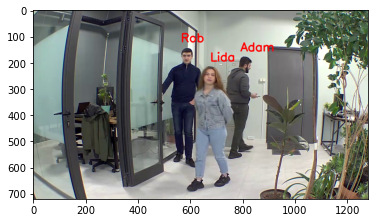

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.69565    0.043478           0]
 [   0.043478     0.82609           0]]


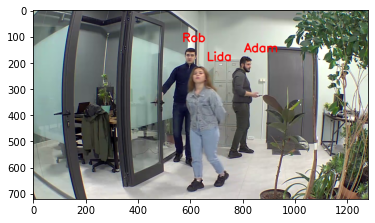

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.56522     0.95652           0]
 [   0.086957    0.043478           0]]


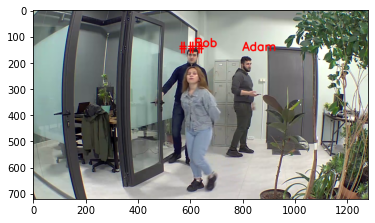

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652]
 [    0.65217           0]
 [    0.43478           0]]


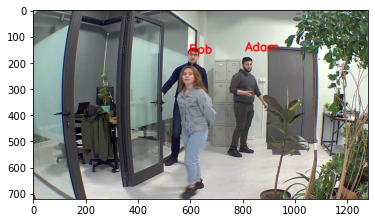

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.13043     0.26087           0]
 [    0.95652     0.82609           0]]


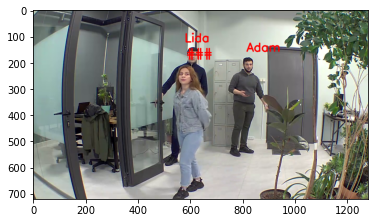

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [          0     0.17391           0]
 [    0.95652     0.82609           0]]


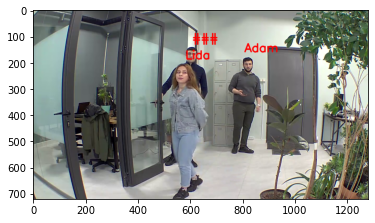

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [          0     0.30435           0]
 [    0.95652     0.78261           0]]


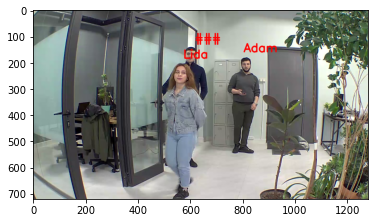

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [   0.086957      0.6087           0]
 [    0.95652     0.21739           0]]


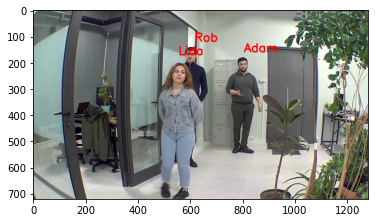

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [   0.043478     0.78261           0]
 [    0.95652    0.086957           0]]


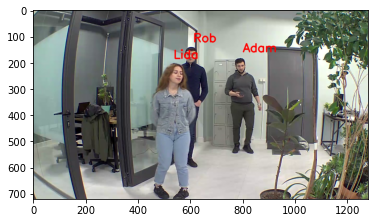

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [          0           1           0]
 [    0.95652    0.043478           0]]


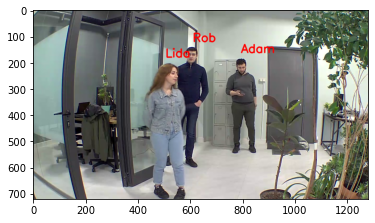

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [          0           1           0]
 [   0.086957    0.043478           0]]


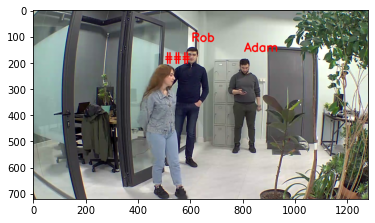

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [          0     0.95652           0]
 [    0.17391    0.043478           0]]


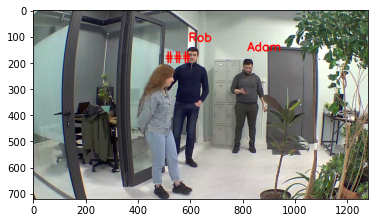

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [   0.043478     0.95652           0]
 [    0.17391    0.043478           0]]


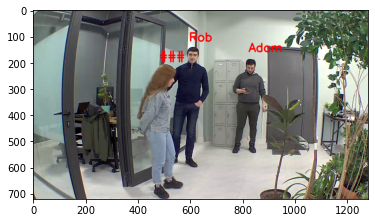

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [   0.043478     0.91304           0]
 [    0.21739    0.043478           0]]


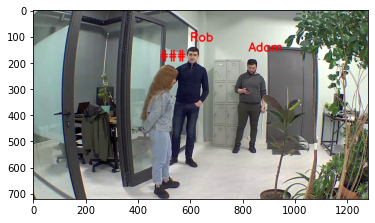

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [   0.043478     0.95652           0]
 [    0.26087    0.043478           0]]


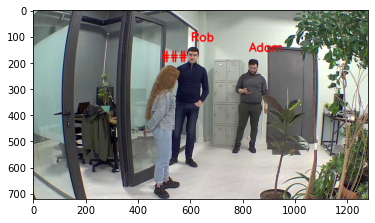

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [          0     0.95652           0]
 [    0.95652    0.043478           0]]


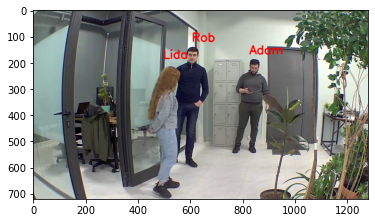

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [          0     0.95652           0]
 [    0.56522    0.043478           0]]


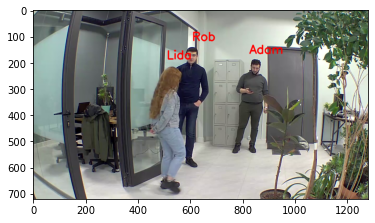

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.17391     0.95652           0]
 [    0.21739    0.043478           0]]


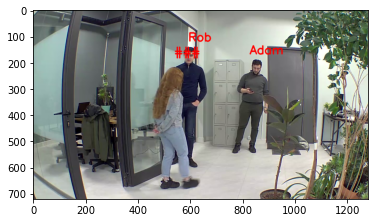

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [    0.21739           0]
 [    0.34783           0]]


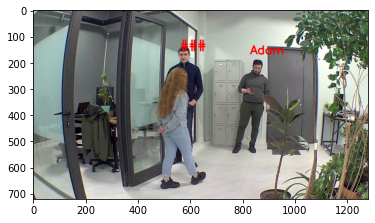

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [    0.34783           0]
 [    0.73913           0]]


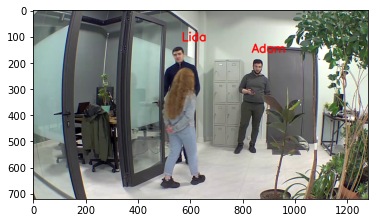

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [          0           0]
 [     0.3913           0]]


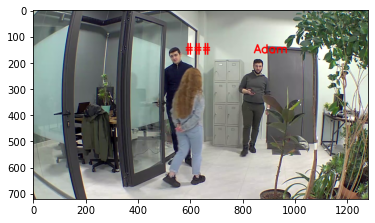

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [   0.043478           0]
 [    0.26087           0]]


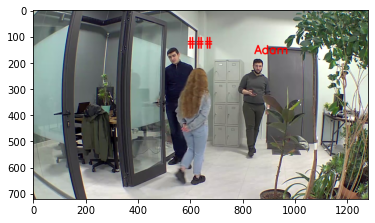

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [     0.3913           0           0]
 [    0.91304     0.17391           0]]


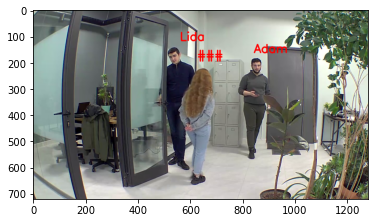

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.69565           0           0]
 [    0.26087     0.47826           0]]


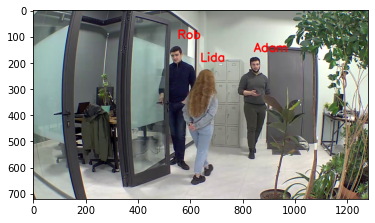

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.73913           0           0]
 [    0.17391     0.95652           0]]


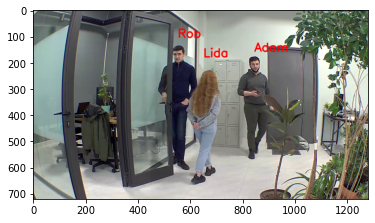

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [    0.95652           0           0]
 [   0.043478     0.95652           0]]


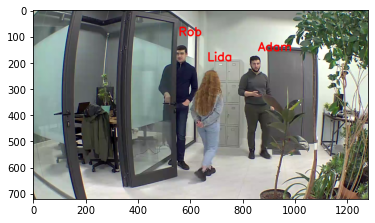

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [          1           0           0]
 [   0.043478     0.91304           0]]


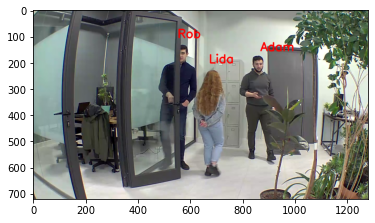

--------------------------------------------------------------------------------
after first threshold
 [[    0.56522           0     0.86957]
 [    0.30435    0.043478           0]
 [          0     0.13043           0]]


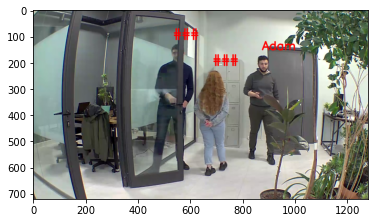

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0     0.82609]
 [    0.86957    0.043478    0.086957]
 [          0    0.086957           0]]


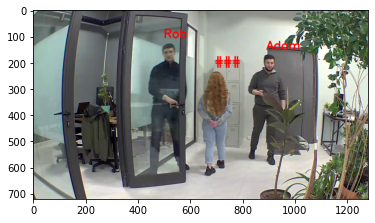

--------------------------------------------------------------------------------
after first threshold
 [[   0.086957           0           1]
 [    0.47826    0.043478           0]
 [          0     0.17391           0]]


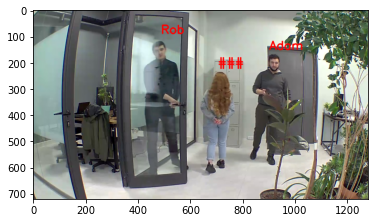

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0     0.95652]
 [   0.043478    0.043478    0.043478]
 [          0     0.13043           0]]


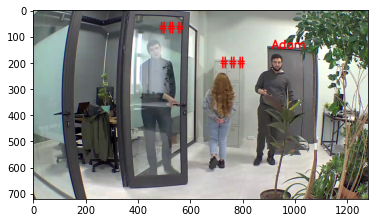

--------------------------------------------------------------------------------
after first threshold
 [[    0.34783           0     0.95652]
 [    0.13043    0.043478    0.043478]
 [          0      0.6087           0]]


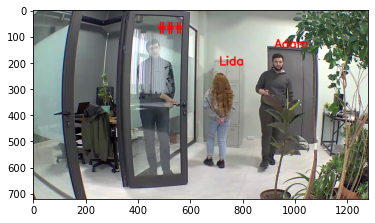

--------------------------------------------------------------------------------
after first threshold
 [[    0.21739           0     0.86957]
 [    0.13043    0.043478    0.086957]
 [          0     0.65217           0]]


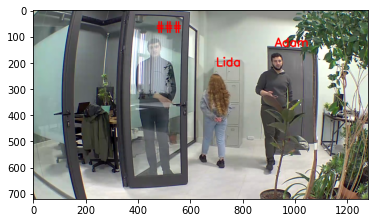

--------------------------------------------------------------------------------
after first threshold
 [[    0.30435           0     0.82609]
 [    0.56522           0    0.086957]
 [          0     0.95652           0]]


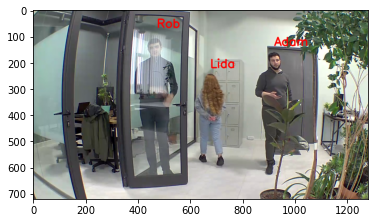

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.95652]
 [    0.34783    0.043478    0.043478]
 [          0     0.91304           0]]


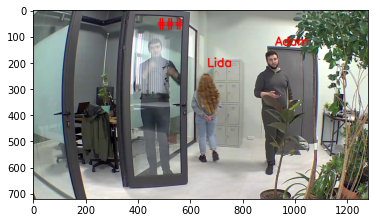

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652]
 [   0.086957           0]
 [    0.65217           0]]


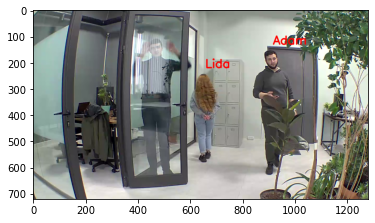

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.86957]
 [   0.043478    0.043478]
 [    0.13043           0]]


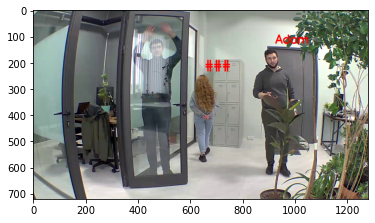

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652]
 [   0.043478           0]
 [    0.13043           0]]


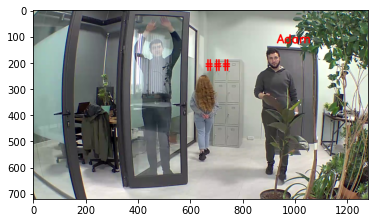

--------------------------------------------------------------------------------
after first threshold
 [[          0           1]
 [   0.043478           0]
 [   0.043478           0]]


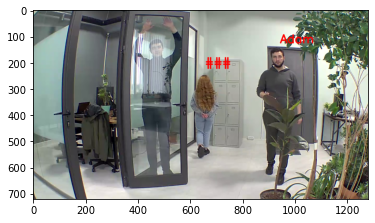

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.82609]
 [   0.086957    0.043478]
 [    0.13043           0]]


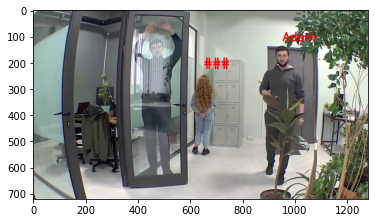

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304]
 [    0.52174           0]
 [    0.21739           0]]


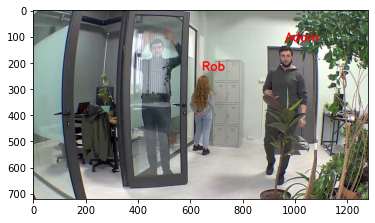

--------------------------------------------------------------------------------
after first threshold
 [[    0.69565           0     0.86957]
 [    0.21739     0.26087           0]
 [          0     0.21739           0]]


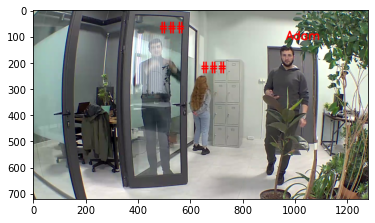

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.73913]
 [    0.47826     0.26087    0.043478]
 [          0     0.30435           0]]


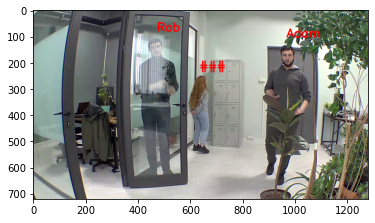

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.86957]
 [    0.34783     0.26087    0.043478]
 [          0     0.34783           0]]


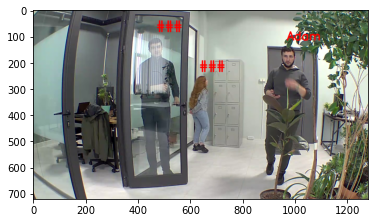

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0     0.95652]
 [    0.13043     0.26087           0]
 [          0     0.95652           0]]


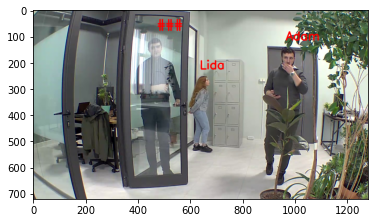

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [   0.043478    0.043478           0]
 [          0     0.82609           0]]


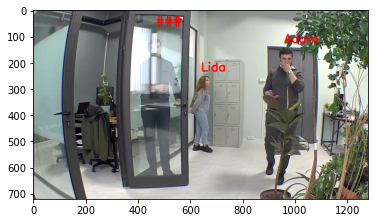

--------------------------------------------------------------------------------
after first threshold
 [[          0           1]
 [    0.43478           0]
 [    0.95652           0]]


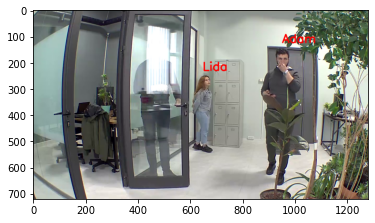

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.91304]
 [    0.21739     0.26087           0]
 [          0     0.95652           0]]


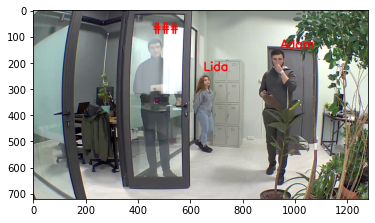

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.91304]
 [    0.26087    0.086957           0]
 [          0     0.95652           0]]


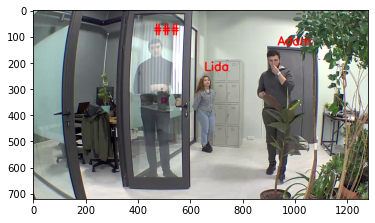

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           1]
 [    0.34783           0           0]
 [          0     0.95652           0]]


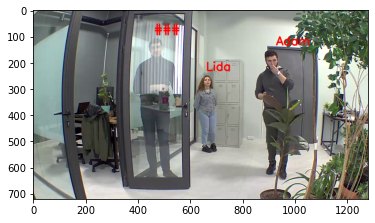

--------------------------------------------------------------------------------
after first threshold
 [[    0.21739           0     0.95652]
 [     0.3913           0           0]
 [          0     0.95652           0]]


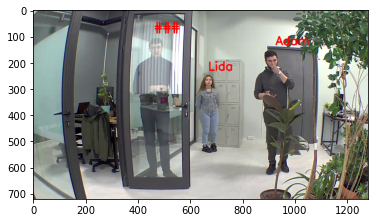

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.86957]
 [     0.6087    0.043478    0.086957]
 [          0     0.78261           0]]


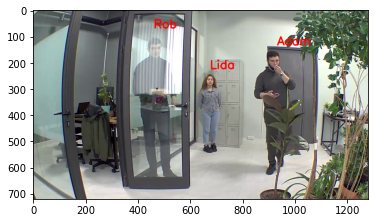

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0     0.86957]
 [    0.56522    0.043478    0.086957]
 [          0     0.82609           0]]


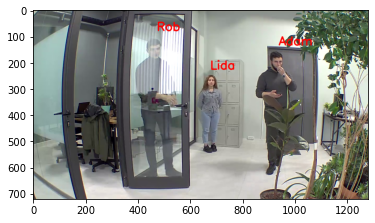

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.73913]
 [    0.21739    0.043478    0.086957]
 [          0     0.86957           0]]


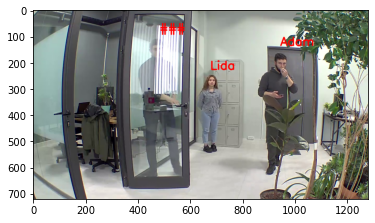

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.73913]
 [   0.043478     0.17391]
 [    0.91304           0]]


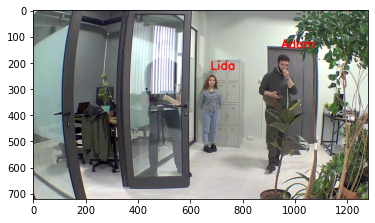

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.95652]
 [   0.043478    0.043478]
 [    0.91304           0]]


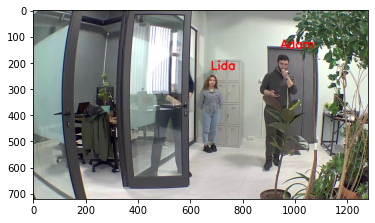

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0     0.95652]
 [    0.86957           0           0]
 [          0     0.95652           0]]


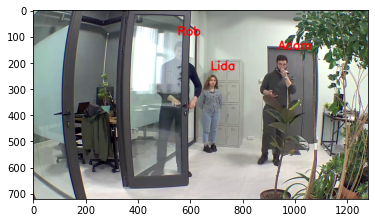

--------------------------------------------------------------------------------
after first threshold
 [[     0.3913           0     0.95652]
 [    0.78261           0           0]
 [          0     0.95652           0]]


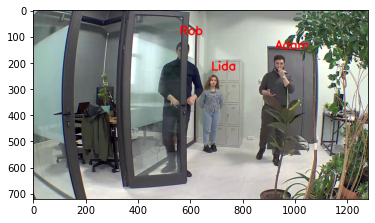

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0     0.91304]
 [    0.95652           0           0]
 [          0     0.91304           0]]


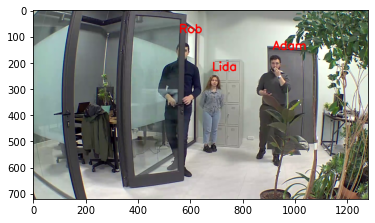

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.95652           0           0]
 [   0.043478     0.91304           0]]


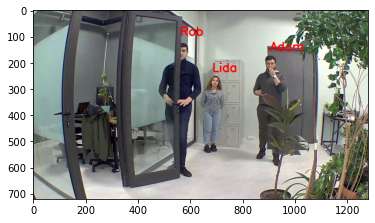

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.78261    0.043478           0]
 [    0.17391     0.91304           0]]


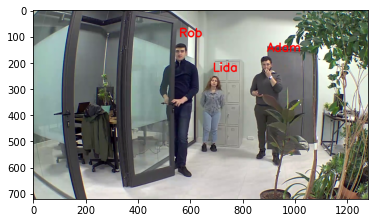

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.91304    0.043478           0]
 [          0     0.91304           0]]


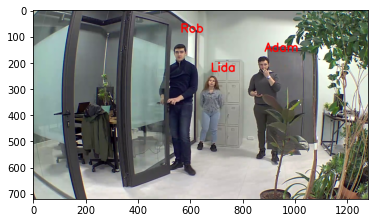

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652    0.043478           0]
 [          0     0.86957           0]]


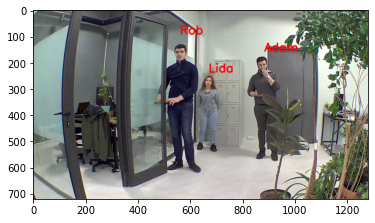

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [          1           0           0]
 [   0.043478     0.95652           0]]


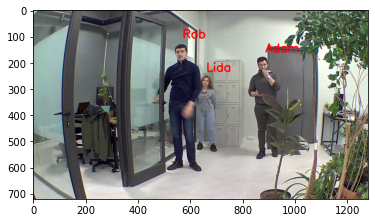

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652           0           0]
 [          0     0.82609           0]]


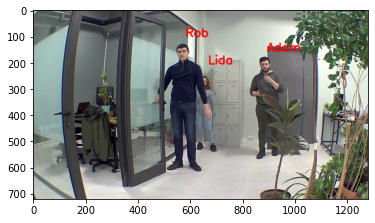

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.91304]
 [    0.95652    0.043478]
 [          0           0]]


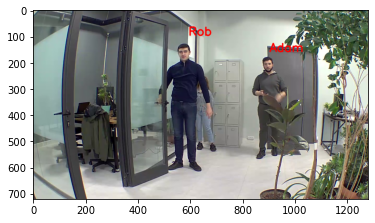

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652           0           0]
 [          0     0.21739           0]]


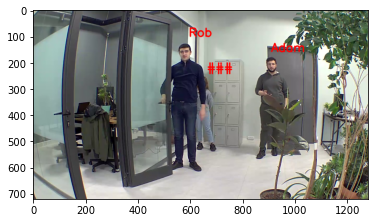

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652           0           0]
 [   0.043478     0.82609           0]]


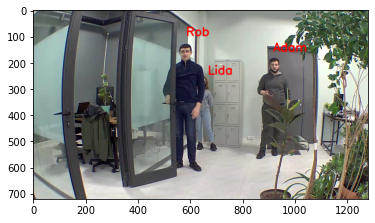

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652           0           0]
 [   0.043478     0.82609           0]]


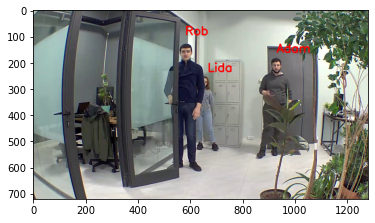

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [          1           0    0.043478]
 [   0.043478     0.82609           0]]


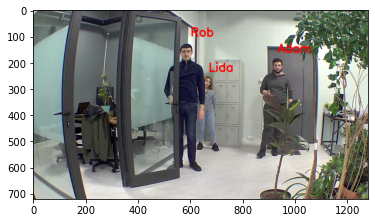

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [          1           0           0]
 [   0.043478     0.82609           0]]


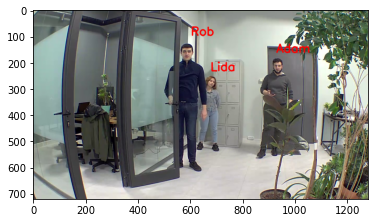

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [          1           0           0]
 [   0.043478     0.82609           0]]


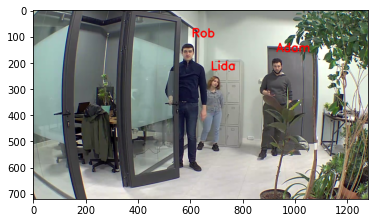

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [          1           0           0]
 [   0.043478     0.95652           0]]


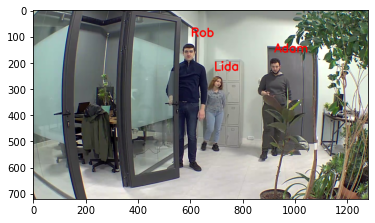

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652           0           0]
 [   0.043478     0.95652           0]]


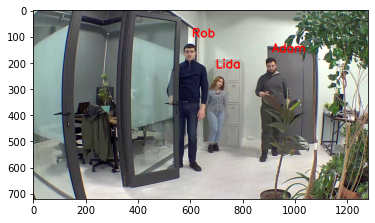

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652           0    0.043478]
 [   0.043478     0.95652           0]]


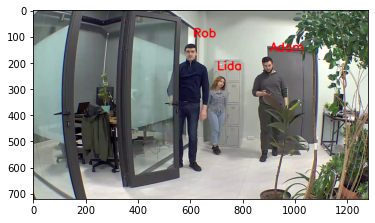

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652    0.043478    0.043478]
 [   0.043478     0.82609           0]]


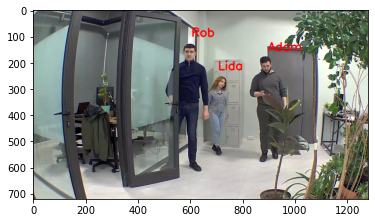

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.95652    0.043478    0.043478]
 [          0     0.78261           0]]


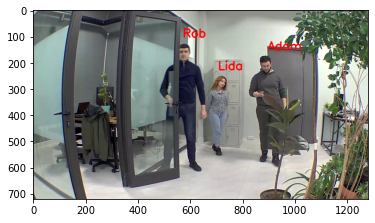

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652    0.043478    0.043478]
 [          0     0.82609           0]]


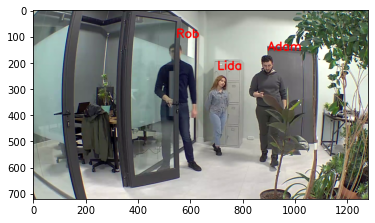

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652    0.043478           0]
 [   0.043478           1           0]]


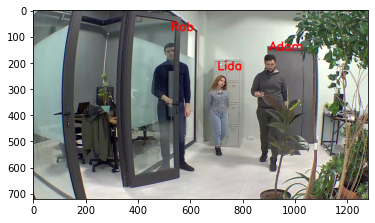

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652    0.086957    0.043478]
 [   0.043478     0.91304           0]]


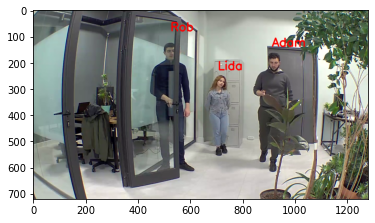

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [          1    0.043478           0]
 [   0.043478     0.91304           0]]


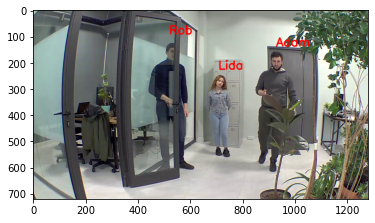

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.95652    0.043478    0.043478]
 [          0     0.73913           0]]


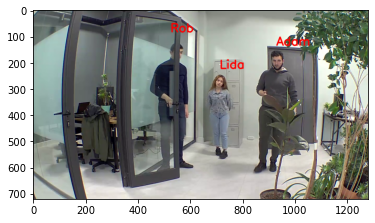

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0     0.95652]
 [    0.95652    0.043478    0.043478]
 [          0     0.69565           0]]


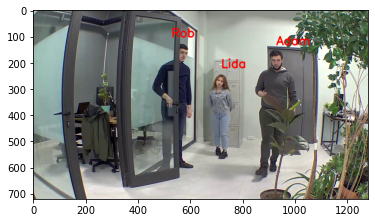

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.95652    0.043478           0]
 [   0.043478     0.73913           0]]


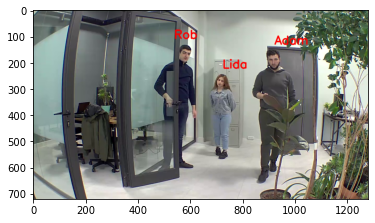

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [    0.95652    0.043478    0.043478]
 [   0.043478     0.65217           0]]


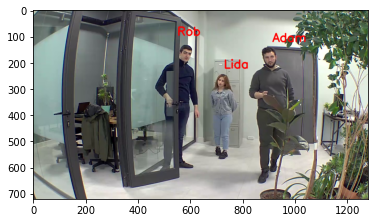

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [    0.95652    0.043478    0.086957]
 [   0.043478     0.56522           0]]


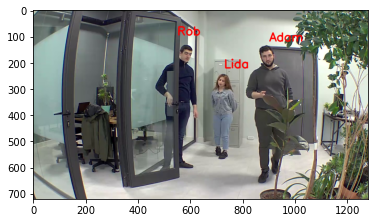

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652    0.043478           0]
 [   0.043478      0.6087           0]]


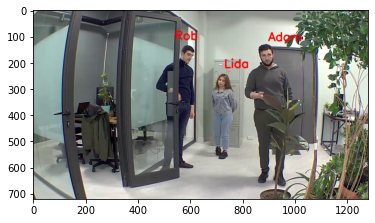

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.95652    0.043478           0]
 [   0.043478     0.52174           0]]


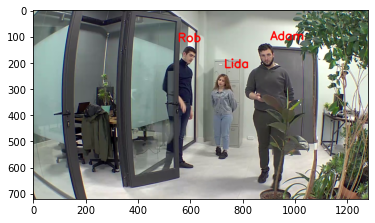

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           1]
 [    0.91304    0.043478           0]
 [   0.043478      0.6087           0]]


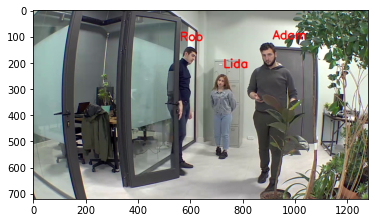

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [     0.6087    0.043478    0.086957]
 [          0     0.73913           0]]


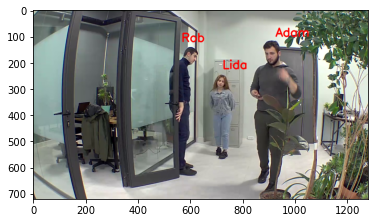

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.82609]
 [     0.6087    0.043478    0.086957]
 [          0     0.73913           0]]


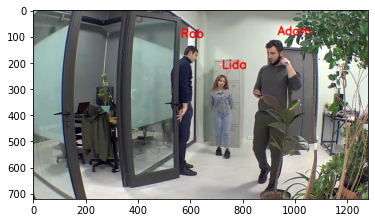

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [    0.78261    0.043478    0.086957]
 [   0.043478     0.82609           0]]


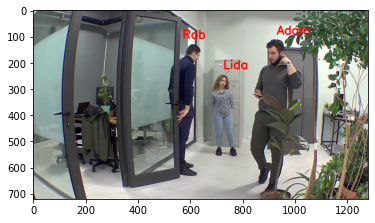

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.86957]
 [    0.82609    0.043478    0.086957]
 [   0.043478     0.82609           0]]


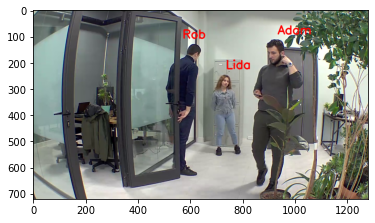

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.82609]
 [    0.95652    0.043478     0.13043]
 [   0.043478     0.95652           0]]


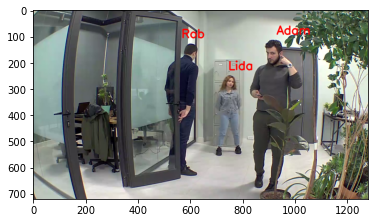

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.91304]
 [    0.91304    0.043478    0.086957]
 [   0.043478     0.82609           0]]


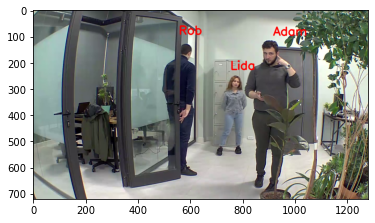

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0           1]
 [    0.95652           0           0]
 [          0     0.95652           0]]


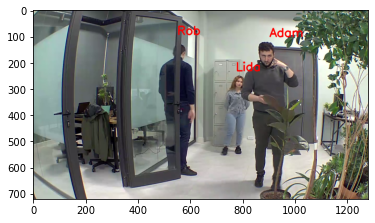

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0           1]
 [    0.95652           0           0]
 [          0     0.95652           0]]


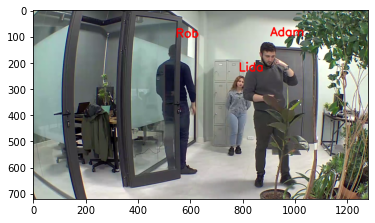

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0           0           1]
 [    0.95652     0.52174           0           0]
 [          0    0.086957     0.95652           0]]


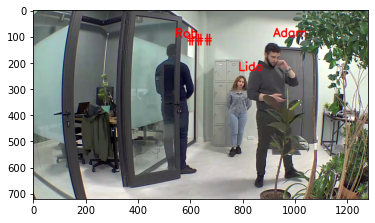

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0     0.95652]
 [    0.95652    0.043478           0]
 [          0     0.73913           0]]


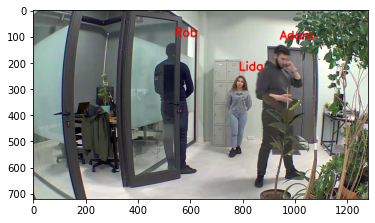

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0     0.21739]
 [    0.95652    0.043478      0.3913]
 [          0     0.82609           0]]


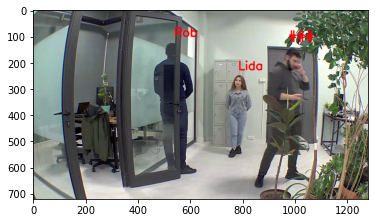

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0]
 [    0.95652    0.043478]
 [          0     0.73913]]


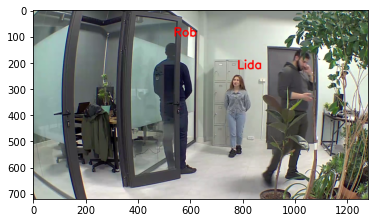

--------------------------------------------------------------------------------
after first threshold
 [[    0.17391           0]
 [    0.86957    0.086957]
 [          0     0.82609]]


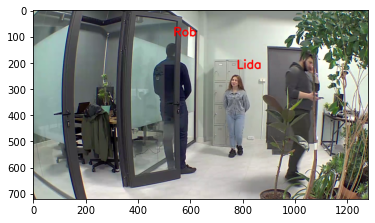

--------------------------------------------------------------------------------
after first threshold
 [[    0.17391     0.26087           0     0.21739]
 [    0.91304     0.82609    0.043478           0]
 [          0           0     0.82609           0]]


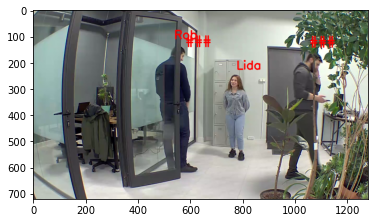

--------------------------------------------------------------------------------
after first threshold
 [[    0.43478           0]
 [    0.69565    0.043478]
 [          0     0.73913]]


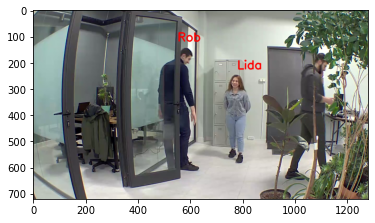

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0     0.73913]
 [    0.91304    0.043478     0.17391]
 [          0     0.21739           0]]


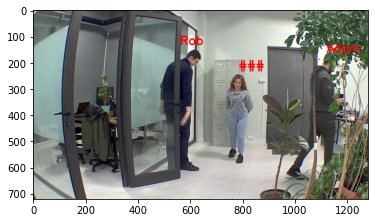

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.21739           0]
 [    0.21739     0.17391]]


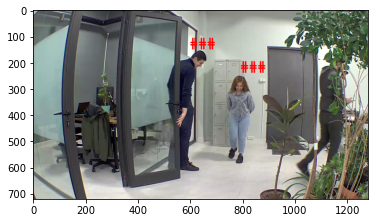

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.21739           0]
 [    0.43478     0.30435]]


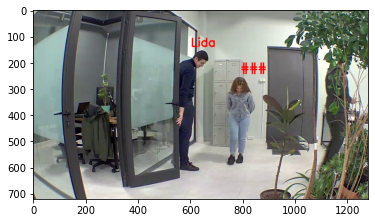

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.30435           0]
 [    0.52174    0.043478]]


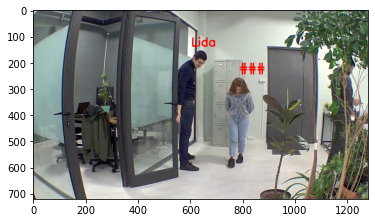

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.82609           0]
 [    0.17391    0.043478]]


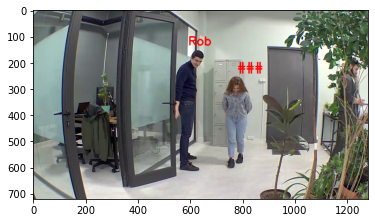

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.82609           0]
 [   0.043478     0.13043]]


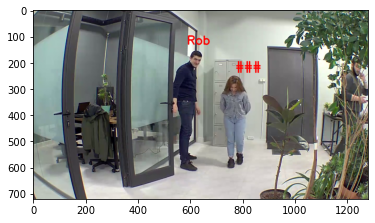

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.91304           0]
 [   0.043478     0.73913]]


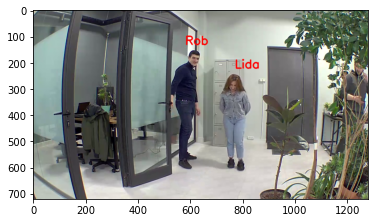

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652           0]
 [   0.043478     0.17391]]


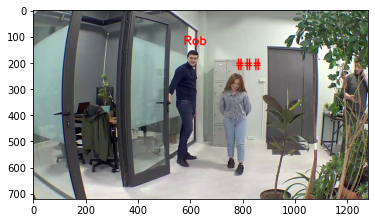

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652    0.043478]
 [   0.043478     0.73913]]


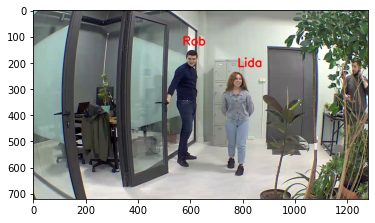

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652    0.043478]
 [   0.043478     0.52174]]


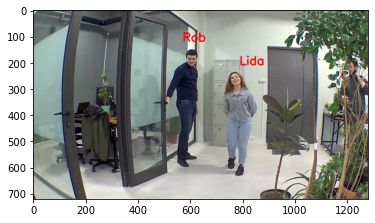

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [          1    0.043478]
 [          0     0.65217]]


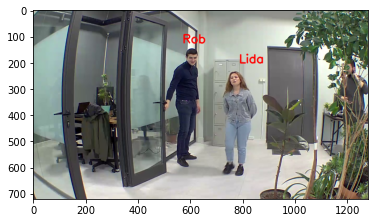

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652    0.043478]
 [          0     0.73913]]


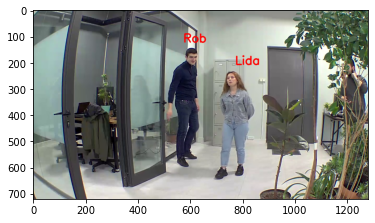

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652    0.043478]
 [   0.043478     0.73913]]


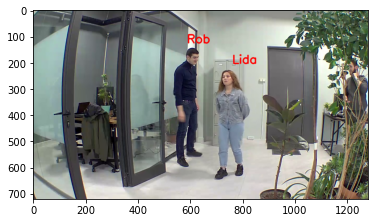

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478           0]
 [    0.95652    0.086957]
 [          0     0.86957]]


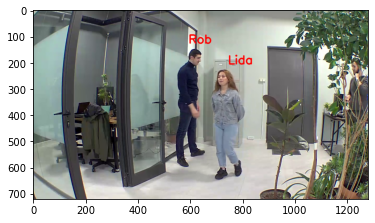

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043           0]
 [    0.95652    0.043478]
 [          0     0.82609]]


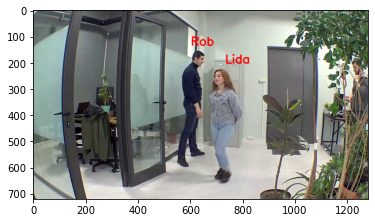

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652           0]
 [          0     0.91304]]


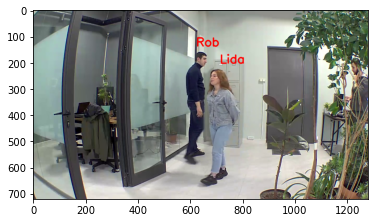

--------------------------------------------------------------------------------
after first threshold
 [[    0.17391           0]
 [    0.86957    0.086957]
 [          0     0.95652]]


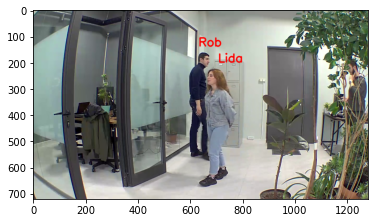

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.43478           0]
 [   0.086957     0.95652]]


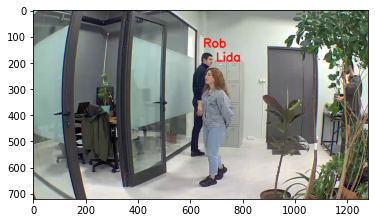

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.13043           0]
 [    0.95652     0.95652]]


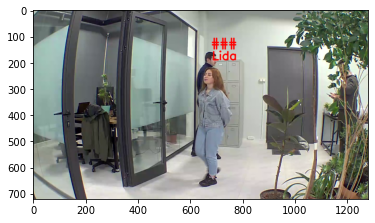

--------------------------------------------------------------------------------
after first threshold
 [[          0]
 [    0.21739]
 [    0.43478]]


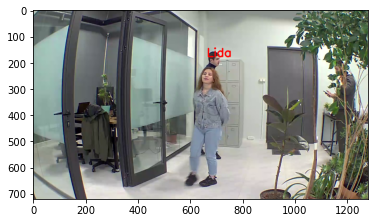

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [     0.3913           0]
 [    0.82609     0.95652]]


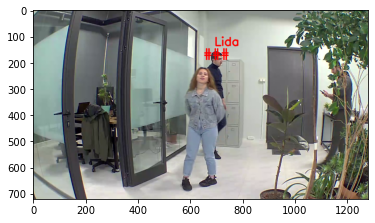

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [          0     0.86957]
 [    0.95652           0]]


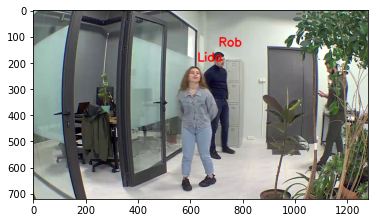

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [          0     0.91304]
 [    0.95652           0]]


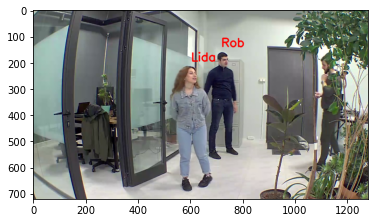

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.30435     0.95652]
 [    0.21739           0]]


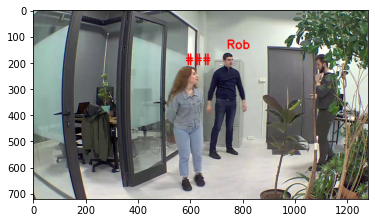

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.21739     0.95652]
 [    0.52174    0.043478]]


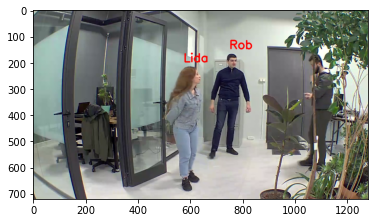

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [   0.086957     0.95652]
 [    0.86957    0.043478]]


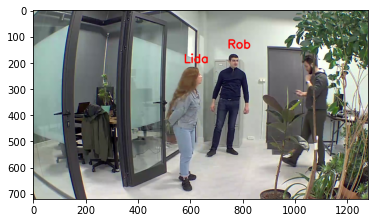

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [   0.043478     0.95652]
 [    0.91304    0.043478]]


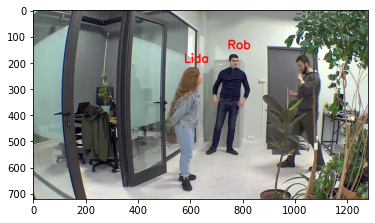

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0]
 [     0.3913           0     0.91304]
 [          0     0.95652    0.043478]]


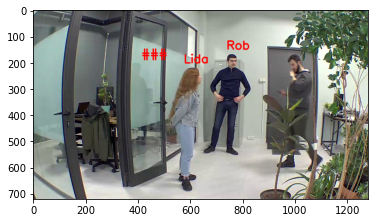

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0           0]
 [     0.3913    0.043478     0.91304           0]
 [          0     0.95652    0.043478    0.086957]]


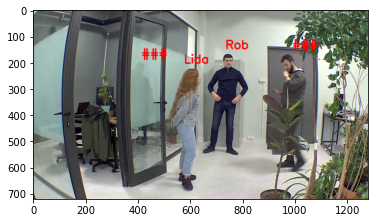

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0           0]
 [    0.52174    0.086957     0.91304           0]
 [          0     0.95652           0     0.73913]]


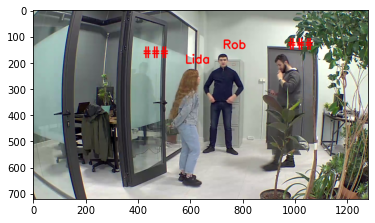

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0]
 [   0.043478     0.91304           0]
 [    0.82609           0     0.86957]]


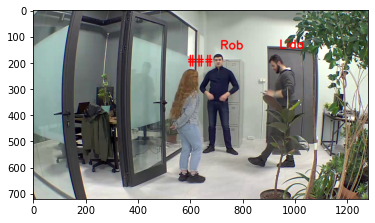

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0]
 [          0     0.69565     0.26087]
 [    0.26087           0     0.86957]]


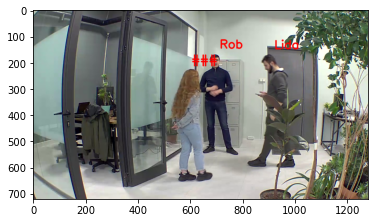

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0     0.82609]
 [    0.52174           0     0.65217    0.043478]
 [          0     0.26087    0.086957           0]]


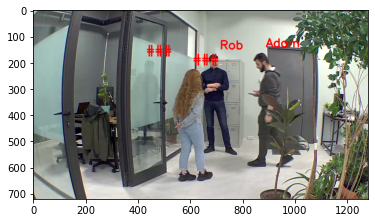

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0     0.86957]
 [    0.30435           0     0.47826    0.043478]
 [          0     0.26087    0.043478           0]]


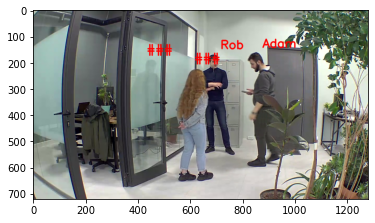

--------------------------------------------------------------------------------
after first threshold
 [[          0           0           0     0.86957]
 [   0.086957           0     0.43478    0.086957]
 [          0     0.78261    0.043478           0]]


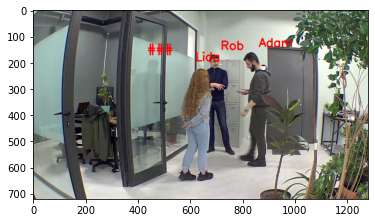

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.65217]
 [   0.043478     0.69565    0.043478]
 [    0.95652    0.086957           0]]


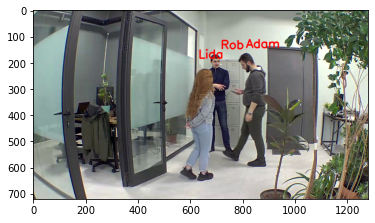

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.95652]
 [    0.21739     0.65217    0.043478]
 [    0.95652     0.13043           0]]


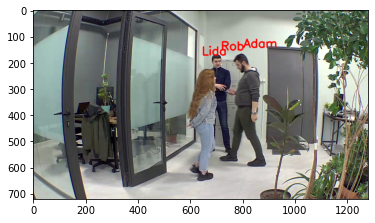

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.78261]
 [   0.043478     0.82609           0]
 [    0.86957     0.17391           0]]


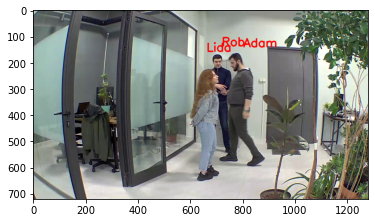

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.47826]
 [   0.043478           0     0.43478]
 [   0.043478     0.82609           0]]


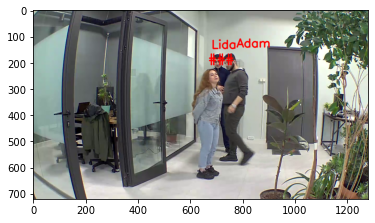

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.52174]
 [    0.91304    0.086957]
 [   0.043478           0]]


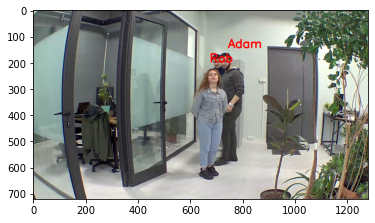

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.52174]
 [    0.47826    0.086957]
 [    0.78261           0]]


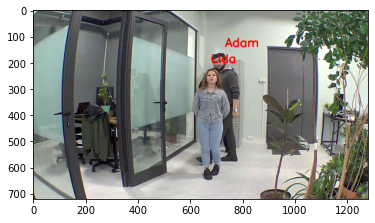

--------------------------------------------------------------------------------
after first threshold
 [[          0     0.34783]
 [    0.95652    0.043478]
 [   0.043478           0]]


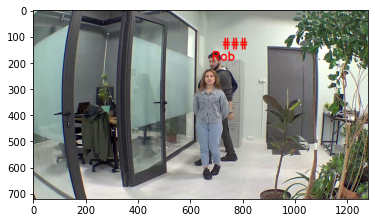

--------------------------------------------------------------------------------
after first threshold
 [[          0           0     0.13043]
 [    0.26087           0     0.95652]
 [    0.95652     0.95652           0]]


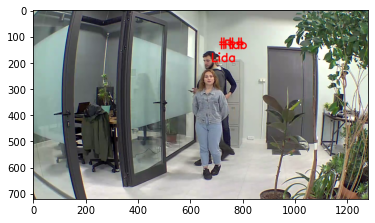

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [          0     0.73913]
 [    0.86957     0.17391]]


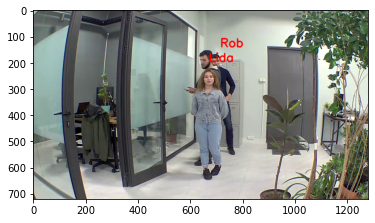

--------------------------------------------------------------------------------
after first threshold
 [[    0.26087           0           0           0]
 [    0.69565     0.30435     0.30435     0.78261]
 [          0    0.086957     0.95652    0.043478]]


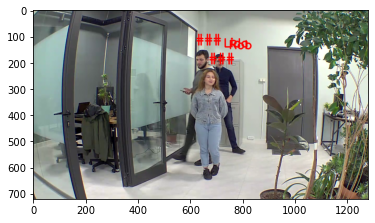

--------------------------------------------------------------------------------
after first threshold
 [[    0.73913           0           0]
 [    0.13043     0.43478     0.95652]
 [          0     0.86957    0.043478]]


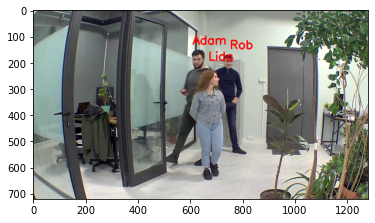

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0    0.043478     0.95652]
 [          0     0.78261    0.043478]]


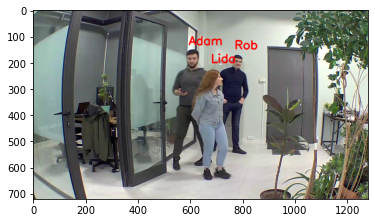

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0    0.043478     0.95652]
 [          0     0.43478    0.043478]]


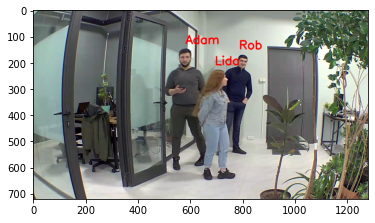

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0           0     0.91304]
 [          0     0.65217    0.043478]]


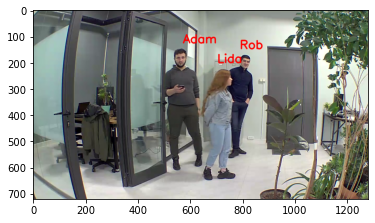

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0           0     0.91304]
 [          0     0.56522    0.043478]]


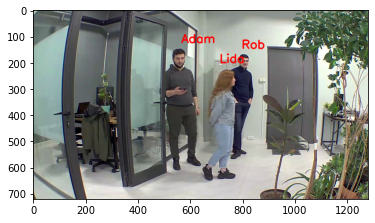

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0           0     0.95652]
 [          0     0.47826    0.043478]]


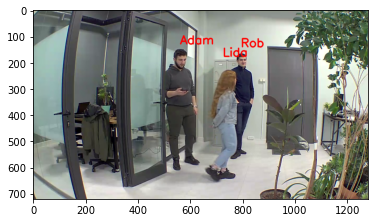

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0     0.21739     0.95652]
 [          0     0.21739    0.043478]]


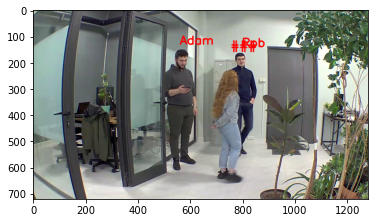

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0     0.26087     0.95652]
 [          0     0.47826    0.043478]]


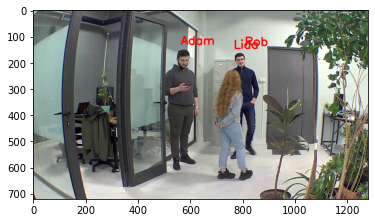

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.47826     0.91304]
 [          0     0.82609    0.043478]]


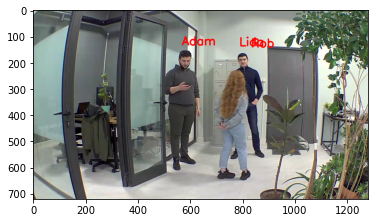

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0     0.34783     0.52174]
 [          0     0.34783     0.21739]]


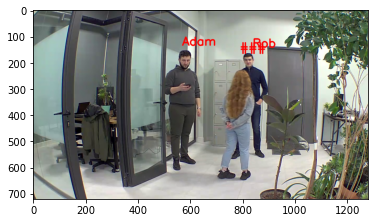

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0      0.6087     0.26087]
 [          0     0.69565     0.26087]]


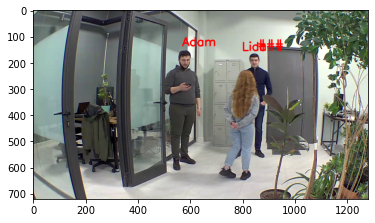

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0           0]
 [          0     0.30435     0.65217     0.52174]
 [          0     0.95652     0.21739    0.086957]]


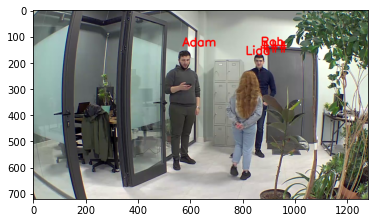

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0           0]
 [          0     0.26087     0.56522     0.30435]
 [          0     0.95652     0.56522     0.43478]]


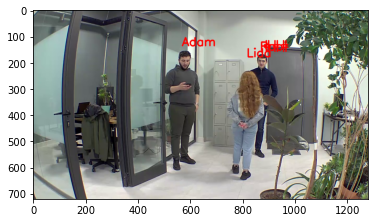

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0           0]
 [          0     0.26087     0.26087     0.34783]
 [          0     0.56522     0.47826           0]]


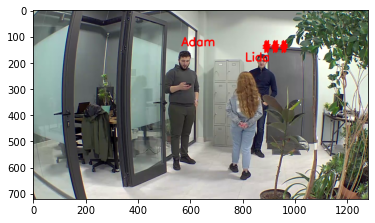

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0           0     0.65217]
 [          0     0.43478     0.26087]]


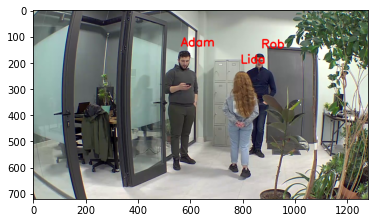

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0           0     0.91304]
 [          0     0.78261    0.043478]]


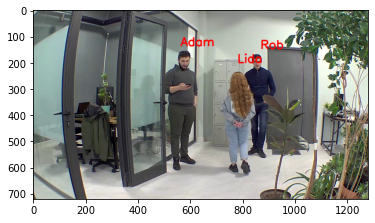

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0           0     0.95652]
 [          0     0.78261    0.043478]]


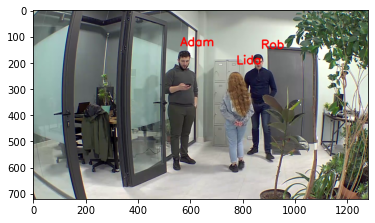

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0           0     0.95652]
 [          0     0.95652    0.043478]]


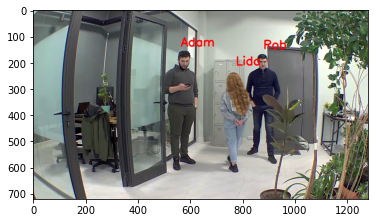

--------------------------------------------------------------------------------
after first threshold
 [[    0.95652           0           0]
 [          0    0.043478           1]
 [          0     0.52174    0.043478]]


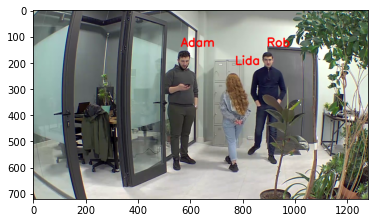

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0    0.043478     0.95652]
 [          0     0.65217    0.043478]]


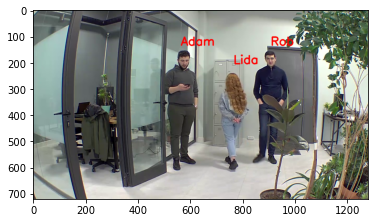

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0    0.043478     0.95652]
 [          0     0.13043    0.043478]]


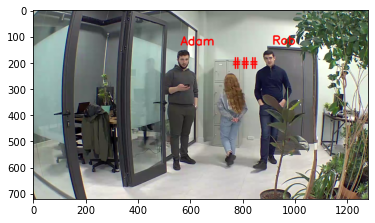

--------------------------------------------------------------------------------
after first threshold
 [[          0           1           0           0]
 [     0.3913           0    0.043478     0.78261]
 [          0           0     0.52174     0.17391]]


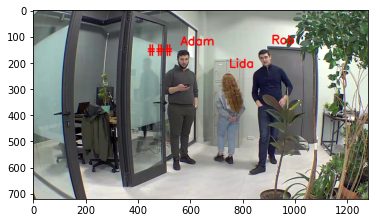

--------------------------------------------------------------------------------
after first threshold
 [[          0           1           0           0]
 [    0.47826           0    0.043478     0.95652]
 [          0           0     0.69565    0.043478]]


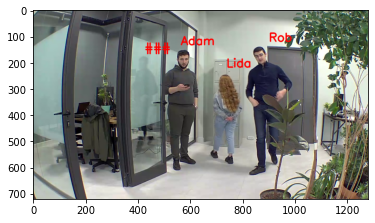

--------------------------------------------------------------------------------
after first threshold
 [[   0.043478     0.86957           0           0]
 [   0.086957           0    0.043478     0.91304]
 [          0           0     0.73913    0.043478]]


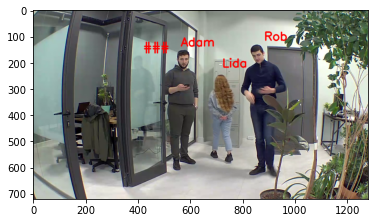

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0    0.043478     0.65217]
 [          0     0.73913     0.13043]]


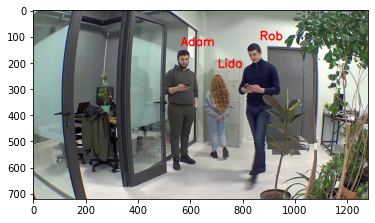

--------------------------------------------------------------------------------
after first threshold
 [[    0.86957           0           0]
 [          0    0.086957     0.43478]
 [          0     0.73913    0.086957]]


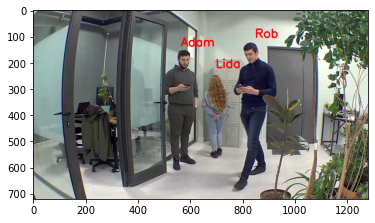

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0           0]
 [          0    0.043478     0.91304]
 [          0     0.13043    0.043478]]


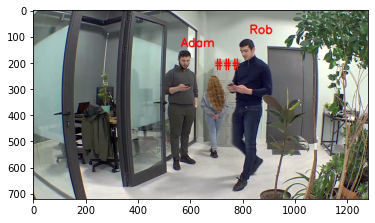

--------------------------------------------------------------------------------
after first threshold
 [[          1           0           0]
 [          0    0.086957     0.69565]
 [          0     0.86957           0]]


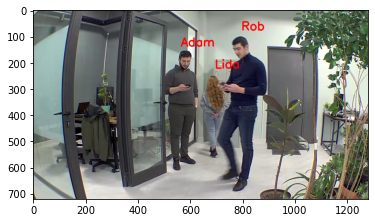

--------------------------------------------------------------------------------
after first threshold
 [[          1           0]
 [          0     0.69565]
 [          0     0.26087]]


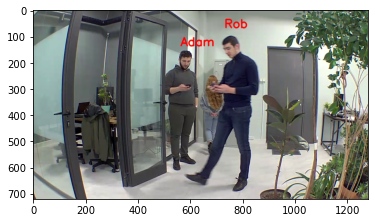

--------------------------------------------------------------------------------
after first threshold
 [[          1           0]
 [          0     0.95652]
 [          0           0]]


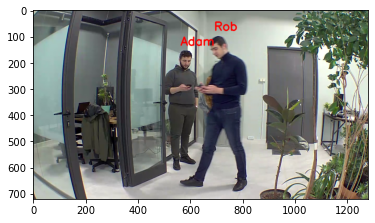

--------------------------------------------------------------------------------
after first threshold
 [[    0.91304           0]
 [          0     0.95652]
 [          0           0]]


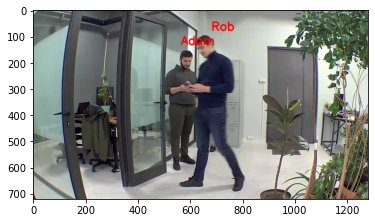

--------------------------------------------------------------------------------
after first threshold
 [[    0.47826           0]
 [    0.13043     0.95652]
 [          0           0]]


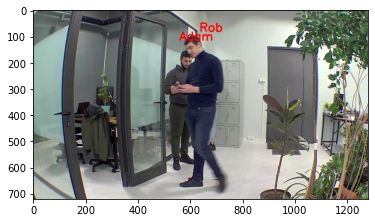

--------------------------------------------------------------------------------
after first threshold
 [[    0.13043]
 [    0.95652]
 [          0]]


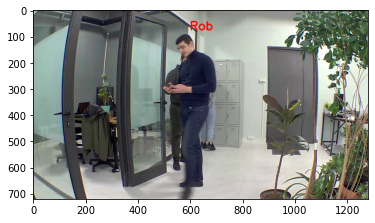

--------------------------------------------------------------------------------
after first threshold
 [[          0           0]
 [    0.95652           0]
 [          0     0.78261]]


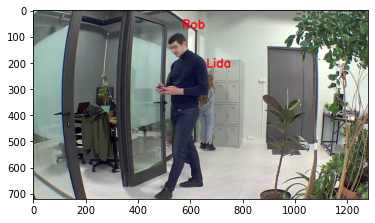

--------------------------------------------------------------------------------


In [23]:
video = 'videos/ARL.MP4'
tresholds = [0.15, 0.4]
frames = []  # used later for saving the videos 
skip_frame = 5
frame_counter = 0
cap = cv2.VideoCapture(video)  # read video from the path

while cap.isOpened():
    ret, frame = cap.read()  # reading frames from the video 
    frame_counter += 1
    
    if frame_counter % skip_frame == 0:
        if ret:
            results = yolo_model(frame)  # feeding frame to yolo model
            result_pandas = results.pandas().xyxy[0]
            # taking only person classes from yolo predictions
            people = result_pandas[result_pandas['name'] == 'person'][['xmin','ymin','xmax','ymax']]
        
            if len(people) == 0:
                continue

            people = people.sort_values('xmin')  # ordering them by X_min values
            people = people.to_numpy().astype(np.int32)

            cropped_imgs_raw = []
            for xyxy in people:
                # cropping person from the frame
                cropped_imgs_raw.append(frame[xyxy[1]:xyxy[3], xyxy[0]:xyxy[2]])           
                
            coords  = people[:, 1:2]  # coordinates for writing the names on the frame
            means_x = (people[:, 0] + people[:, 2]) // 2
            coords  = np.hstack((means_x[:,None], coords))
            
            coords[:, 1] -= 20  
            # getting current frame's people encodings
            encs = reid_model(cropped_imgs_raw).cpu().detach().numpy()
            if len(encs) == 0:
                continue
            # calculating the confusion matrix of matchings
            conf_matr = compute_conf_matr(customer_encs, encs, tresholds)
            # ploting the results
            video_frame = plot_customer_names(frame, conf_matr, coords, customer_names)
            frames.append(video_frame)
        else:
            break

# Save video

In [25]:
# video_save_path = 'Videos/result_ARL.mp4'
# size = (1280, 720) 
# fps = 5
# out = cv2.VideoWriter(video_save_path, cv2.VideoWriter_fourcc(*'DIVX'), fps, size)

# for i in range(len(frames)):
#     out.write(frames[i])
# out.release()